In [ ]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from os.path import exists

## Hyperpameters

Define the hyperparameters. You can play with those later.

In [ ]:
## Data loading

workers = 4 # Number of workers for dataloader (/!\ set to 4 when you're done debugging)

## Architecture

arch = 'cDCGAN' # or cGAN
nz = 100 # Size of z latent vector (i.e. size of generator input)µ
ndf = 32 # Base size of feature maps in discriminator
ngf = 32 # Base size of feature maps in generator

## Optimization

lrD = 0.0002 # Learning rate for the discriminator
lrG = 0.0002 # Learning rate for the generator
beta1G = 0.5 # Momentum beta1 for the discriminator
beta1D = 0.5 # Momentum beta1 for the generator

## Training

batch_size = 128 # Images per batch
nb_update_D = 1 # Number of sub-steps of discriminator optim. at each step
nb_update_G = 1 # Number of sub-steps of generator optim. at each step
#steps = 8000 # Number of global steps in the training loop
nb_epochs = 20 # Number of epochs, leave "None" if you want to set the number of "steps" (i.e. batches)


if nb_epochs is None:
    nb_epochs = (steps * batch_size) / (nb_update_D * 50000)
else:
    steps = int(nb_epochs * nb_update_D * 50000 / batch_size)
print("Doing %.1f epochs in %d steps" % (nb_epochs, steps))
steps_per_epoch = int(steps / nb_epochs)

Doing 20.0 epochs in 7812 steps


# Dataset

Download and load the dataset. Nothing to do here.

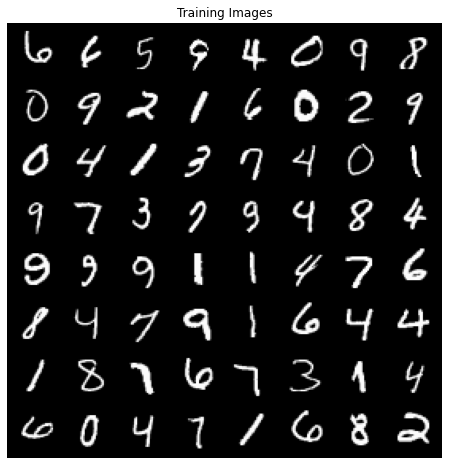

In [ ]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataroot = '/tmp/mnist'
transform = transforms.Compose([
        transforms.Pad(2),
        transforms.ToTensor(),
        transforms.Normalize((0.5,), (0.5,))
])
dataset = dset.MNIST(dataroot, train=True, download=True, transform=transform)
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

# Model architectures

## Discriminator

Input: Image $x \in \mathbb{R}^{32\times 32\times 1}$  
Output: "Real" image probability $\in [0,1]$

## Generator

Input: Random "noise" $z \in \mathbb{R}^{\text{nz}}$  
Output: Generated image $\tilde x \in \mathbb{R}^{32\times 32\times 1}$


In [ ]:
# cDCGAN

if arch == 'cDCGAN':
    
    class Discriminator(nn.Module):
        def __init__(self):
            super(Discriminator, self).__init__()
            self.emb_x = nn.Sequential(
                nn.Conv2d(1, 64, 4, 2, 1),
                nn.LeakyReLU(0.2)
            )
            self.emb_y = nn.Sequential(
                nn.Conv2d(10, 64, 4, 2, 1),
                nn.LeakyReLU(0.2)
            )
            self.emb_xy = nn.Sequential(
                nn.Conv2d(64+64, 256, 4, 2, 1, bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(0.2),
                nn.Conv2d(256, 512, 4, 2, 1, bias=False),
                nn.BatchNorm2d(512),
                nn.LeakyReLU(0.2),
                nn.Conv2d(512, 1, 4, 1, 0),
                nn.Sigmoid()
            )

        def forward(self, x, y):
            d_x=self.emb_x(x)
            y=y.expand(x.shape[0],10,32,32)
            d_y=self.emb_y(y)
            xy=torch.cat((d_x,d_y),dim=1)
            o = self.emb_xy(xy)
            return o



    class Generator(nn.Module):
        def __init__(self):
            super(Generator, self).__init__()
            self.emb_z = nn.Sequential(
                nn.ConvTranspose2d(nz, 256, 4, 1, 0, bias=False),
                nn.BatchNorm2d(256),
                nn.ReLU()
            )
            self.emb_y = nn.Sequential(
                nn.ConvTranspose2d(10, 256, 4, 1, 0, bias=False),
                nn.BatchNorm2d(256),
                nn.ReLU()
            )
            self.emb_zy = nn.Sequential(
                nn.ConvTranspose2d(256+256, 256, 4, 2, 1, bias=False),
                nn.BatchNorm2d(256),
                nn.ReLU(),
                nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
                nn.BatchNorm2d(128),
                nn.ReLU(),
                nn.ConvTranspose2d(128, 1, 4, 2, 1),
                nn.Tanh()
            )

        def forward(self, z, y):
            d_z=self.emb_z(z)
            d_y=self.emb_y(y)
            zy=torch.cat((d_z,d_y),dim=1)
            o=self.emb_zy(zy)
            return o

In [ ]:
# cGAN

if arch == 'cGAN':
    class Discriminator(nn.Module):
        def __init__(self):
            super(Discriminator, self).__init__()
            self.emb_x = nn.Sequential(
                nn.Linear(32*32*1,1024),
                nn.LeakyReLU(0.2)
            )
            self.emb_y = nn.Sequential(
                nn.Linear(10,1024),
                nn.LeakyReLU(0.2)
            )
            self.emb_xy = nn.Sequential(
                nn.Linear(1024+1024,1024, bias=False),
                nn.BatchNorm1d(1024),
                nn.LeakyReLU(0.2),
                nn.Linear(1024,512, bias=False),
                nn.BatchNorm1d(512),
                nn.LeakyReLU(0.2),
                nn.Linear(512,1),
                nn.Sigmoid()
            )

        def forward(self, x, y):
            x = x.view(x.shape[0], -1) # z[:, :, 0, 0] #(batch_size, channel, size,size)
            y = y.view(y.shape[0], -1)
            d_x=self.emb_x(x)
            d_y=self.emb_y(y)
            xy=torch.cat((d_x,d_y),dim=1)
            o=self.emb_xy(xy).unsqueeze(dim=2).unsqueeze(dim=3)
            return o



    class Generator(nn.Module):
        def __init__(self):
            super(Generator, self).__init__()
            self.emb_z = nn.Sequential(
                nn.Linear(nz, 256, bias=False),
                nn.BatchNorm1d(256),
                nn.ReLU()
            )
            self.emb_y = nn.Sequential(
                nn.Linear(10, 256, bias=False),
                nn.BatchNorm1d(256),
                nn.ReLU()
            )
            self.emb_zy = nn.Sequential(
                nn.Linear(256+256, 512, bias=False),
                nn.BatchNorm1d(512),
                nn.ReLU(),
                nn.Linear(512, 1024, bias=False),
                nn.BatchNorm1d(1024),
                nn.ReLU(),
                nn.Linear(1024, 1024),
                nn.Tanh()
            )

        def forward(self, z, y):
            # Remove unused dimensions in non-conv model
            z = z.view(z.shape[0], -1) # z[:, :, 0, 0] #(batch_size, channel, size,size)
            y = y.view(y.shape[0], -1)
            #print("z shape",z.shape)
            #print("embedding z")
            d_z=self.emb_z(z)
            #print("embedding done")
            d_y=self.emb_y(y)
            #print("dz shape",d_z.shape,"d_y shape",d_y.shape)
            zy=torch.cat((d_z,d_y),dim=1)
            #print("zy shape",zy.shape)
            out=self.emb_zy(zy).view(z.shape[0],1,32,32)
            return out

In [ ]:
# Create the models
netG = Generator().to(device)
netD = Discriminator().to(device)

# Apply the weights_init function to randomly initialize all weights to mean=0, stdev=0.2
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
netG.apply(weights_init)
netD.apply(weights_init)

# Print the models
print(netG)
print(netD)

Generator(
  (emb_z): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (emb_y): Sequential(
    (0): ConvTranspose2d(10, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
  )
  (emb_zy): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(128, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): Tanh()
  )
)
Discriminator(
  (emb_

In [ ]:
# TODO test you models to check if they 
z = torch.zeros(10, nz, 1, 1).to(device)
x = torch.zeros(10, 1, 32, 32).to(device)
y = torch.randn(10, 10, 1, 1).to(device)
print(netG(z, y).shape) # expected: [10, 1, 32, 32]
print(netD(x, y).shape) # expected: [10, 1, 1, 1]

torch.Size([10, 1, 32, 32])
torch.Size([10, 1, 1, 1])


In [ ]:
nz

100

# Optimization and training

Here we will define:
* Our prior $P(z)$ that we use to sample random "noise". We will use a Gaussian distribution.
* The criterion that will be used to train the discriminator, and indirectly the generator. We will use the binary cross-entropy.
* The optimizers of both models. We will use the Adam optimizer.

In [ ]:
# Prior P(z). Returns a Gaussian random tensor of shape (batch_size, nz, 1, 1)
def get_noise(batch_size):
    noise = torch.randn((batch_size,nz,1,1)).to(device)
    return noise

# Returns a random vector of one-hot encoding of shape (batch_size, 10, 1, 1)
def get_fixed_y(batch_size):
    y = torch.zeros(batch_size, 10, 1, 1, device=device)
    n = batch_size // 10
    for i in range(10):
        y[i*n:i*n+n, i, :, :].fill_(1)
    return y

# Create the criterion function that will take (y_hat, y) as input
criterion = nn.BCELoss()

# Setup Adam optimizers for D and G
optimizerD = torch.optim.Adam(netD.parameters(),lr=lrD,betas=(beta1D,0.999))
optimizerG = torch.optim.Adam(netG.parameters(),lr=lrG,betas=(beta1G,0.999))

### Data format / batch creation functions

`r_real` and `r_fake` are targets for the disriminator's criterion

In [ ]:
# Data format / batch creation functions

fixed_noise = get_noise(100) # Create a fixed random vector sampled from a Gaussian, will be used during train for viz
fixed_y = get_fixed_y(100)
real_label = 1.0
fake_label = 0.0
iterator = iter(dataloader)

def onehot(data, nclass=10):
    bsize = data.shape[0]
    y = torch.zeros(bsize, nclass)
    y.scatter_(1, data.unsqueeze(1), 1)
    y = y.unsqueeze(2).unsqueeze(3)
    return y

# returns a batch of real images from the dataset (iterates infinitely on the dataset)
def get_batch_real():
    global iterator
    try:
        x_real, y_real = next(iterator)
    except:
        iterator = iter(dataloader)
        x_real, y_real = next(iterator)
    x_real = x_real.to(device)
    y_real = onehot(y_real).to(device)
    r_real = torch.full((x_real.size(0),), real_label, device=device)
    return x_real, y_real, r_real

# returns a batch of generated images and training targets y_fake
# Note that the targets y_fake will be different is train_G is True or False
def get_batch_fake(y_real, train_G=False):
    z = torch.randn(y_real.shape[0], nz, 1, 1, device=device)
    x_fake = netG(z, y_real)
    if train_G:
        r_fake = torch.full((x_fake.size(0),), real_label, device=device) # TODO
    else:
        r_fake = torch.full((x_fake.size(0),), fake_label, device=device)
    return x_fake, y_real, r_fake

### Training Loop

**Reminder:** when your training loop starts to work, change the `workers` variable to 4 and rerun your notebook

In [ ]:
img_list = []
G_losses = []
D_losses = []

[    0/ 7812]	Loss_D: 1.3459	Loss_G: 3.7780	D(x): 0.5948	D(G(z)): 0.4699


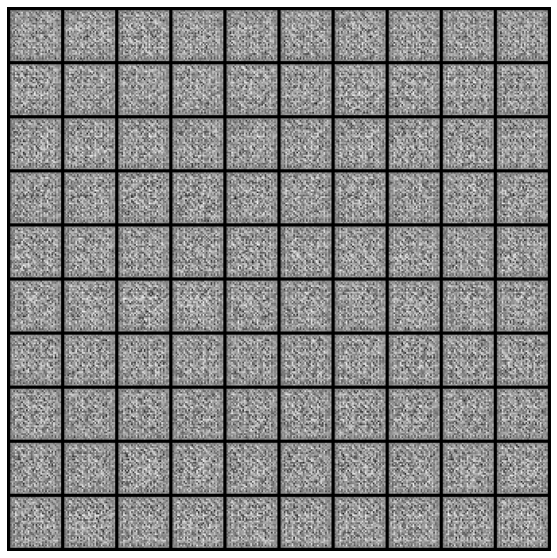

[   25/ 7812]	Loss_D: 0.2603	Loss_G: 2.3326	D(x): 0.8171	D(G(z)): 0.0281
[   50/ 7812]	Loss_D: 0.4550	Loss_G: 3.5573	D(x): 0.8867	D(G(z)): 0.2712
[   75/ 7812]	Loss_D: 0.7406	Loss_G: 1.6288	D(x): 0.5503	D(G(z)): 0.0323
[  100/ 7812]	Loss_D: 0.6089	Loss_G: 5.0386	D(x): 0.8983	D(G(z)): 0.3663


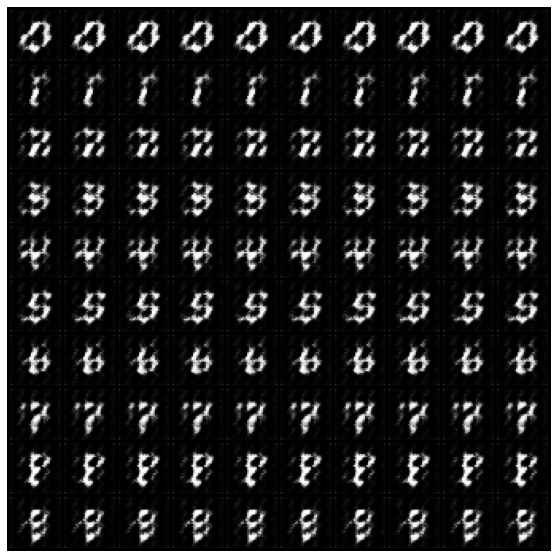

[  125/ 7812]	Loss_D: 0.3138	Loss_G: 3.6903	D(x): 0.9133	D(G(z)): 0.1867
[  150/ 7812]	Loss_D: 1.0036	Loss_G: 2.3054	D(x): 0.4598	D(G(z)): 0.0190
[  175/ 7812]	Loss_D: 0.3461	Loss_G: 2.8035	D(x): 0.8793	D(G(z)): 0.1786
[  200/ 7812]	Loss_D: 1.0352	Loss_G: 3.7657	D(x): 0.7388	D(G(z)): 0.4194


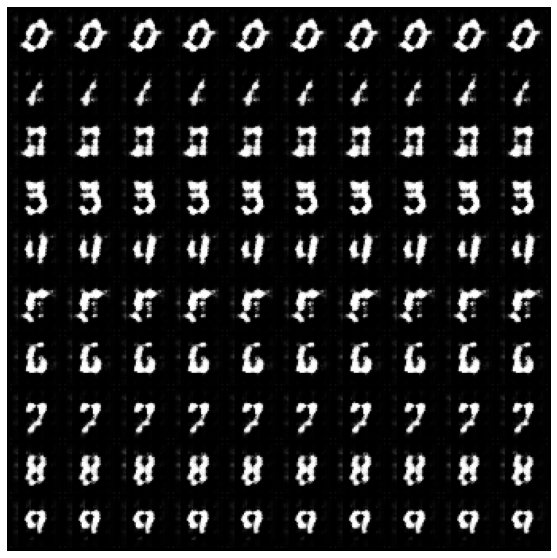

[  225/ 7812]	Loss_D: 0.3742	Loss_G: 3.5419	D(x): 0.8763	D(G(z)): 0.1996
[  250/ 7812]	Loss_D: 0.5441	Loss_G: 3.2851	D(x): 0.8130	D(G(z)): 0.2320
[  275/ 7812]	Loss_D: 0.7703	Loss_G: 5.2481	D(x): 0.8931	D(G(z)): 0.4347
[  300/ 7812]	Loss_D: 0.7885	Loss_G: 2.2874	D(x): 0.5948	D(G(z)): 0.0264


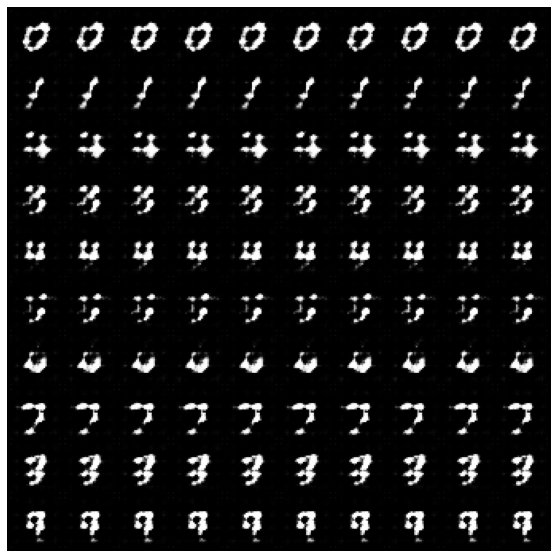

[  325/ 7812]	Loss_D: 1.5100	Loss_G: 6.3973	D(x): 0.7926	D(G(z)): 0.6008
[  350/ 7812]	Loss_D: 0.5378	Loss_G: 4.9866	D(x): 0.9316	D(G(z)): 0.3264
[  375/ 7812]	Loss_D: 0.7954	Loss_G: 2.2151	D(x): 0.6445	D(G(z)): 0.1022
[  400/ 7812]	Loss_D: 0.6588	Loss_G: 2.7167	D(x): 0.7262	D(G(z)): 0.2245


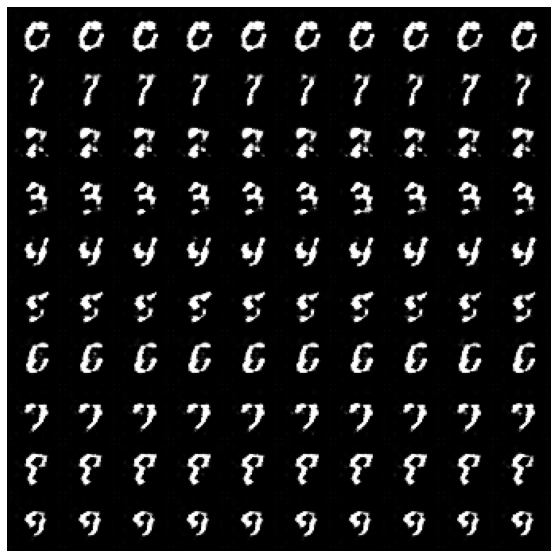

[  425/ 7812]	Loss_D: 0.3689	Loss_G: 2.8733	D(x): 0.8557	D(G(z)): 0.1527
[  450/ 7812]	Loss_D: 0.4992	Loss_G: 1.8544	D(x): 0.7319	D(G(z)): 0.0795
[  475/ 7812]	Loss_D: 0.5448	Loss_G: 3.4825	D(x): 0.8176	D(G(z)): 0.2200
[  500/ 7812]	Loss_D: 0.8914	Loss_G: 2.6817	D(x): 0.6021	D(G(z)): 0.0300


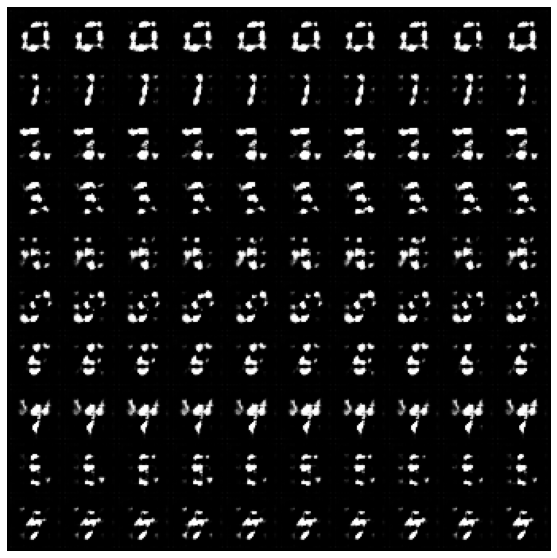

[  525/ 7812]	Loss_D: 0.3225	Loss_G: 3.7152	D(x): 0.8990	D(G(z)): 0.1681
[  550/ 7812]	Loss_D: 0.3137	Loss_G: 3.5114	D(x): 0.9160	D(G(z)): 0.1793
[  575/ 7812]	Loss_D: 0.3866	Loss_G: 3.7272	D(x): 0.8661	D(G(z)): 0.1743
[  600/ 7812]	Loss_D: 0.6219	Loss_G: 4.7989	D(x): 0.8877	D(G(z)): 0.3282


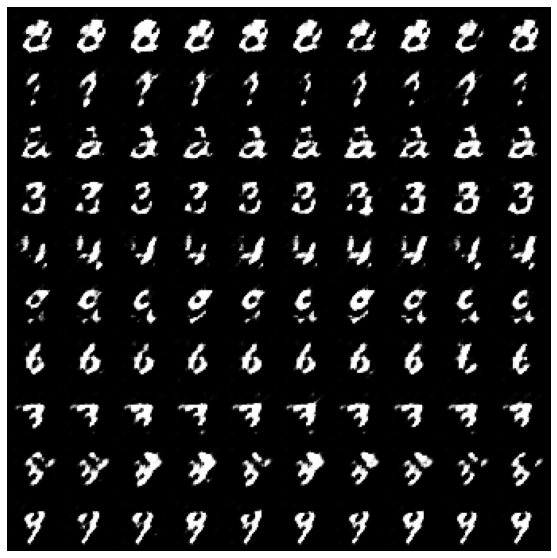

[  625/ 7812]	Loss_D: 0.3575	Loss_G: 2.9226	D(x): 0.8392	D(G(z)): 0.1129
[  650/ 7812]	Loss_D: 0.5395	Loss_G: 2.6180	D(x): 0.7775	D(G(z)): 0.1606
[  675/ 7812]	Loss_D: 0.6165	Loss_G: 4.8261	D(x): 0.8825	D(G(z)): 0.3435
[  700/ 7812]	Loss_D: 0.4502	Loss_G: 3.8556	D(x): 0.8025	D(G(z)): 0.1155


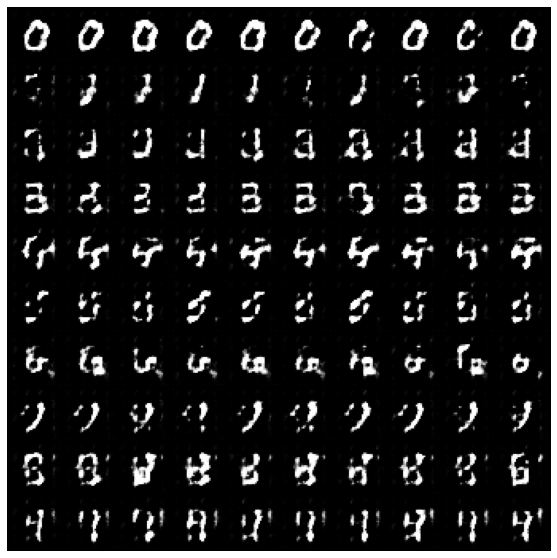

[  725/ 7812]	Loss_D: 0.6618	Loss_G: 1.8380	D(x): 0.6829	D(G(z)): 0.0727
[  750/ 7812]	Loss_D: 1.0316	Loss_G: 4.2438	D(x): 0.9208	D(G(z)): 0.5228
[  775/ 7812]	Loss_D: 0.6669	Loss_G: 3.8910	D(x): 0.8672	D(G(z)): 0.3541
[  800/ 7812]	Loss_D: 0.4865	Loss_G: 2.1053	D(x): 0.7791	D(G(z)): 0.1533


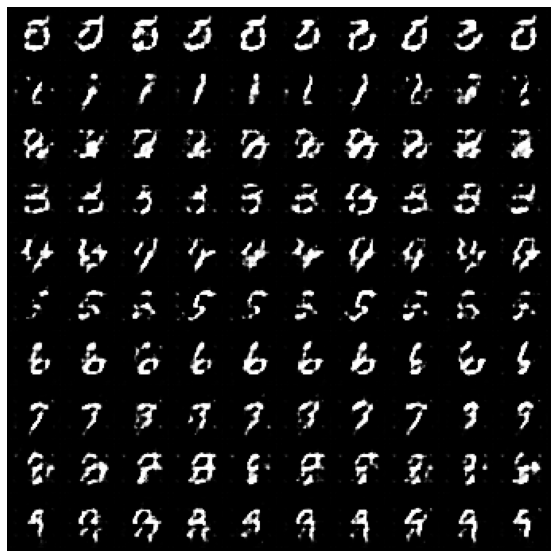

[  825/ 7812]	Loss_D: 0.7767	Loss_G: 1.7197	D(x): 0.6397	D(G(z)): 0.0940
[  850/ 7812]	Loss_D: 1.7834	Loss_G: 5.5418	D(x): 0.9603	D(G(z)): 0.7491
[  875/ 7812]	Loss_D: 0.8243	Loss_G: 1.2764	D(x): 0.5911	D(G(z)): 0.1018
[  900/ 7812]	Loss_D: 0.6254	Loss_G: 1.4205	D(x): 0.6957	D(G(z)): 0.1410


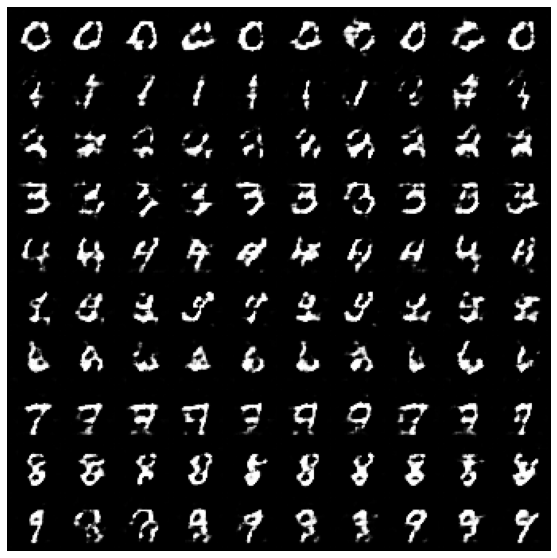

[  925/ 7812]	Loss_D: 1.0106	Loss_G: 1.2511	D(x): 0.5685	D(G(z)): 0.2067
[  950/ 7812]	Loss_D: 0.8432	Loss_G: 3.5225	D(x): 0.8777	D(G(z)): 0.4281
[  975/ 7812]	Loss_D: 0.8733	Loss_G: 2.0199	D(x): 0.7951	D(G(z)): 0.3935
[ 1000/ 7812]	Loss_D: 0.7329	Loss_G: 1.9453	D(x): 0.7173	D(G(z)): 0.2402


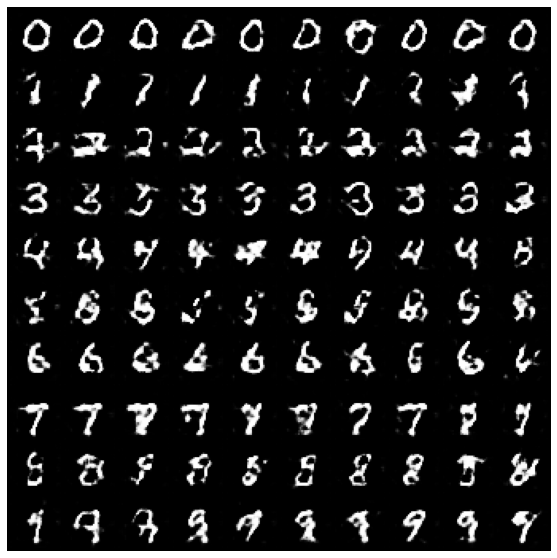

[ 1025/ 7812]	Loss_D: 0.9774	Loss_G: 1.0303	D(x): 0.5282	D(G(z)): 0.1427
[ 1050/ 7812]	Loss_D: 0.9293	Loss_G: 0.9832	D(x): 0.5632	D(G(z)): 0.1776
[ 1075/ 7812]	Loss_D: 0.8503	Loss_G: 2.5914	D(x): 0.8080	D(G(z)): 0.4076
[ 1100/ 7812]	Loss_D: 1.0316	Loss_G: 1.1428	D(x): 0.5144	D(G(z)): 0.1642


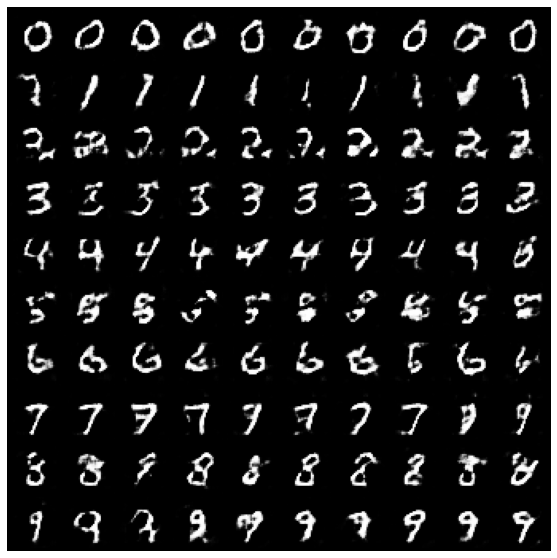

[ 1125/ 7812]	Loss_D: 1.2387	Loss_G: 2.5621	D(x): 0.7641	D(G(z)): 0.5368
[ 1150/ 7812]	Loss_D: 0.8551	Loss_G: 1.7657	D(x): 0.7468	D(G(z)): 0.3439
[ 1175/ 7812]	Loss_D: 0.8499	Loss_G: 1.5569	D(x): 0.6800	D(G(z)): 0.2971
[ 1200/ 7812]	Loss_D: 1.0779	Loss_G: 1.0778	D(x): 0.5616	D(G(z)): 0.2485


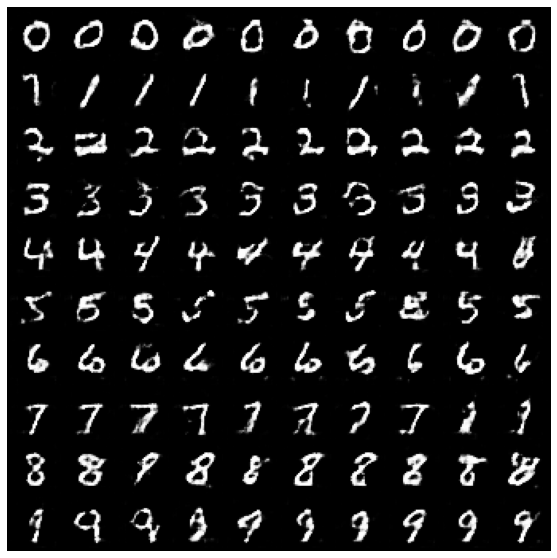

[ 1225/ 7812]	Loss_D: 1.1485	Loss_G: 1.6692	D(x): 0.6534	D(G(z)): 0.4090
[ 1250/ 7812]	Loss_D: 1.2292	Loss_G: 0.7742	D(x): 0.4532	D(G(z)): 0.2132
[ 1275/ 7812]	Loss_D: 1.1975	Loss_G: 0.6360	D(x): 0.4637	D(G(z)): 0.1946
[ 1300/ 7812]	Loss_D: 0.9972	Loss_G: 1.7654	D(x): 0.7231	D(G(z)): 0.4084


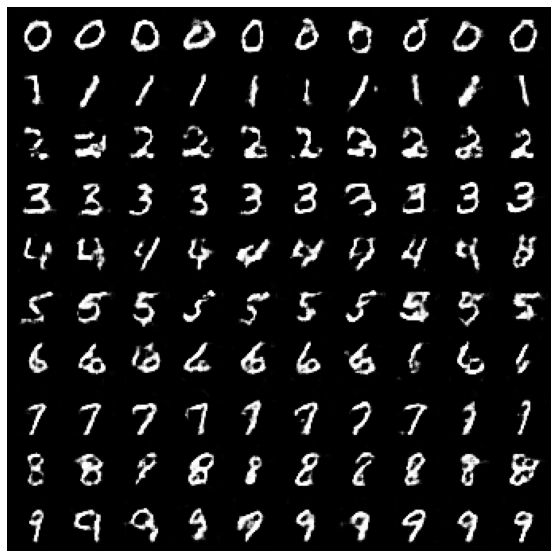

[ 1325/ 7812]	Loss_D: 0.9932	Loss_G: 1.7503	D(x): 0.6578	D(G(z)): 0.3460
[ 1350/ 7812]	Loss_D: 1.1567	Loss_G: 1.1460	D(x): 0.6409	D(G(z)): 0.4290
[ 1375/ 7812]	Loss_D: 1.1829	Loss_G: 1.6409	D(x): 0.6923	D(G(z)): 0.4775
[ 1400/ 7812]	Loss_D: 1.4337	Loss_G: 2.6046	D(x): 0.8936	D(G(z)): 0.6767


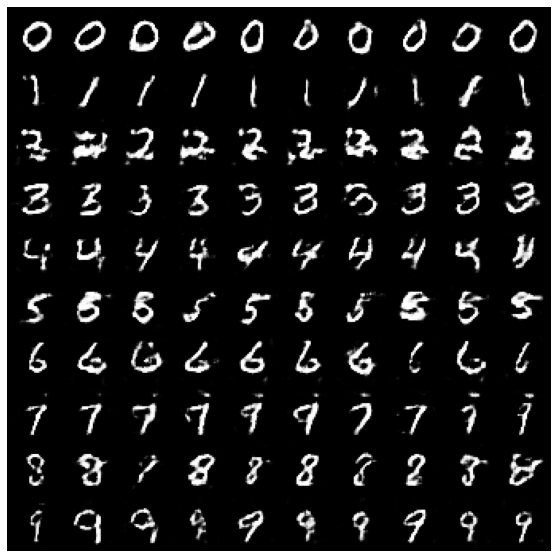

[ 1425/ 7812]	Loss_D: 1.1249	Loss_G: 0.8476	D(x): 0.4919	D(G(z)): 0.2111
[ 1450/ 7812]	Loss_D: 0.9996	Loss_G: 2.0496	D(x): 0.7738	D(G(z)): 0.4743
[ 1475/ 7812]	Loss_D: 1.2831	Loss_G: 0.7508	D(x): 0.4749	D(G(z)): 0.3026
[ 1500/ 7812]	Loss_D: 1.3745	Loss_G: 2.2773	D(x): 0.8063	D(G(z)): 0.6276


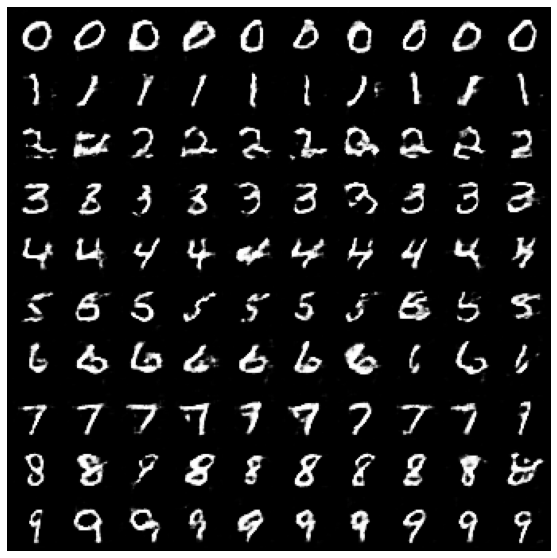

[ 1525/ 7812]	Loss_D: 1.3627	Loss_G: 1.5809	D(x): 0.7466	D(G(z)): 0.5982
[ 1550/ 7812]	Loss_D: 1.0239	Loss_G: 1.2618	D(x): 0.5946	D(G(z)): 0.3237
[ 1575/ 7812]	Loss_D: 1.0610	Loss_G: 1.3671	D(x): 0.5976	D(G(z)): 0.3472
[ 1600/ 7812]	Loss_D: 1.2748	Loss_G: 1.5346	D(x): 0.5910	D(G(z)): 0.4578


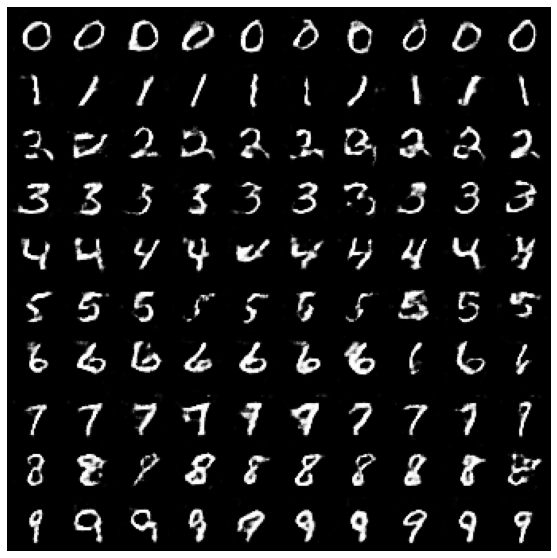

[ 1625/ 7812]	Loss_D: 1.0334	Loss_G: 1.3975	D(x): 0.6762	D(G(z)): 0.4303
[ 1650/ 7812]	Loss_D: 1.2036	Loss_G: 1.5982	D(x): 0.6267	D(G(z)): 0.4524
[ 1675/ 7812]	Loss_D: 1.2296	Loss_G: 1.4189	D(x): 0.6851	D(G(z)): 0.5122
[ 1700/ 7812]	Loss_D: 1.1974	Loss_G: 1.0481	D(x): 0.4761	D(G(z)): 0.2765


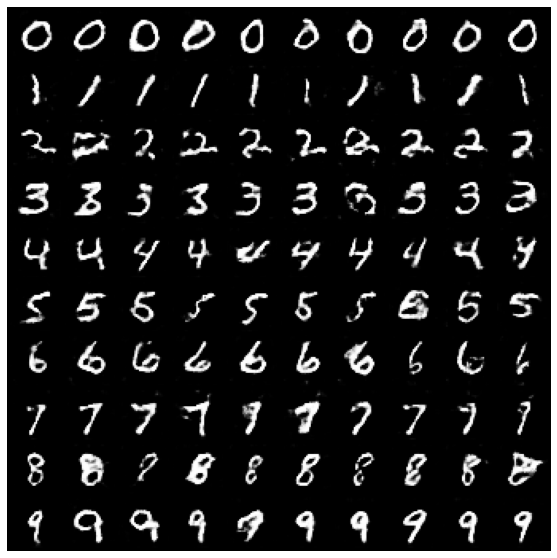

[ 1725/ 7812]	Loss_D: 1.1466	Loss_G: 1.6555	D(x): 0.6858	D(G(z)): 0.4713
[ 1750/ 7812]	Loss_D: 1.2275	Loss_G: 0.7640	D(x): 0.4933	D(G(z)): 0.3096
[ 1775/ 7812]	Loss_D: 1.2660	Loss_G: 0.6377	D(x): 0.4225	D(G(z)): 0.2036
[ 1800/ 7812]	Loss_D: 1.3213	Loss_G: 1.1008	D(x): 0.5885	D(G(z)): 0.4672


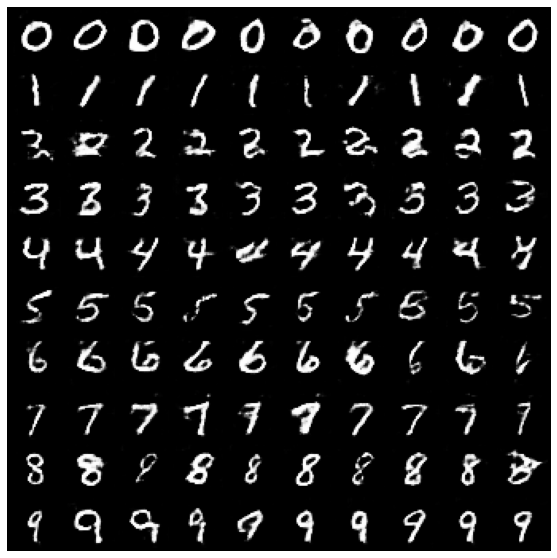

[ 1825/ 7812]	Loss_D: 1.1942	Loss_G: 1.3455	D(x): 0.6679	D(G(z)): 0.4651
[ 1850/ 7812]	Loss_D: 1.3138	Loss_G: 0.7553	D(x): 0.4529	D(G(z)): 0.2695
[ 1875/ 7812]	Loss_D: 1.1902	Loss_G: 1.0194	D(x): 0.5430	D(G(z)): 0.3576
[ 1900/ 7812]	Loss_D: 1.1411	Loss_G: 1.0021	D(x): 0.5946	D(G(z)): 0.3843


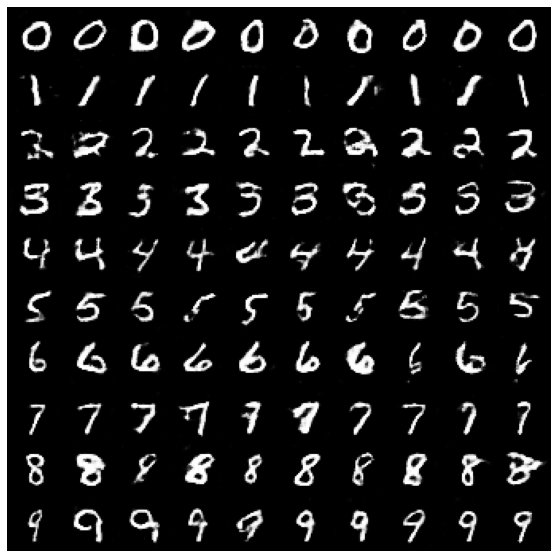

[ 1925/ 7812]	Loss_D: 1.2045	Loss_G: 1.5165	D(x): 0.7134	D(G(z)): 0.5271
[ 1950/ 7812]	Loss_D: 1.1990	Loss_G: 1.1031	D(x): 0.5593	D(G(z)): 0.3943
[ 1975/ 7812]	Loss_D: 1.2282	Loss_G: 1.2600	D(x): 0.6273	D(G(z)): 0.4745
[ 2000/ 7812]	Loss_D: 1.3433	Loss_G: 1.6009	D(x): 0.6451	D(G(z)): 0.5316


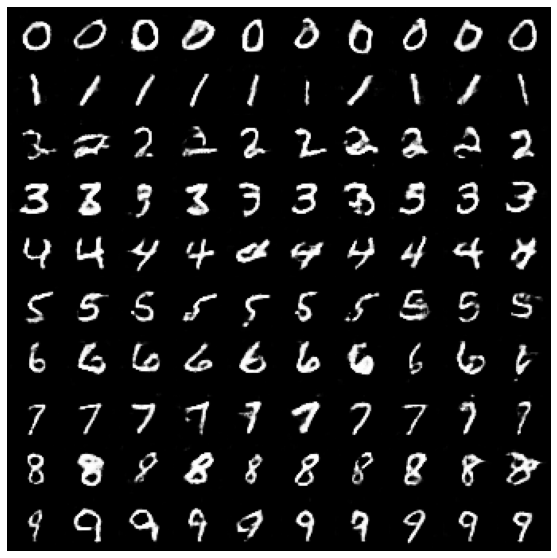

[ 2025/ 7812]	Loss_D: 1.1573	Loss_G: 1.0380	D(x): 0.5249	D(G(z)): 0.3395
[ 2050/ 7812]	Loss_D: 1.2684	Loss_G: 0.8366	D(x): 0.4749	D(G(z)): 0.3301
[ 2075/ 7812]	Loss_D: 1.2100	Loss_G: 0.9721	D(x): 0.5877	D(G(z)): 0.4325
[ 2100/ 7812]	Loss_D: 1.2351	Loss_G: 0.9102	D(x): 0.4791	D(G(z)): 0.2849


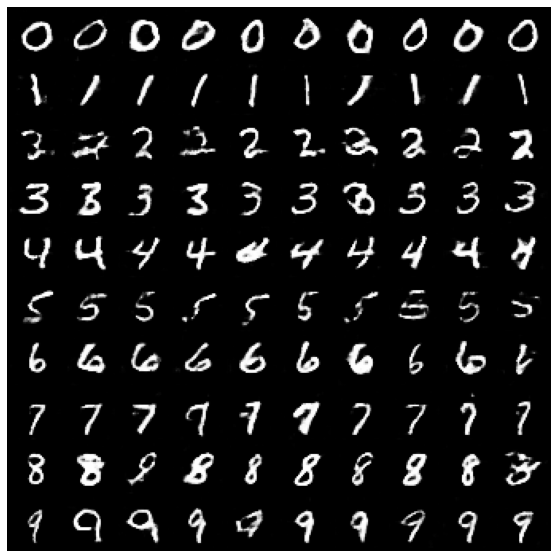

[ 2125/ 7812]	Loss_D: 1.1694	Loss_G: 0.9062	D(x): 0.5294	D(G(z)): 0.3536
[ 2150/ 7812]	Loss_D: 1.1827	Loss_G: 1.4214	D(x): 0.6304	D(G(z)): 0.4588
[ 2175/ 7812]	Loss_D: 1.2714	Loss_G: 0.7469	D(x): 0.5469	D(G(z)): 0.4278
[ 2200/ 7812]	Loss_D: 1.2973	Loss_G: 0.6682	D(x): 0.4712	D(G(z)): 0.3397


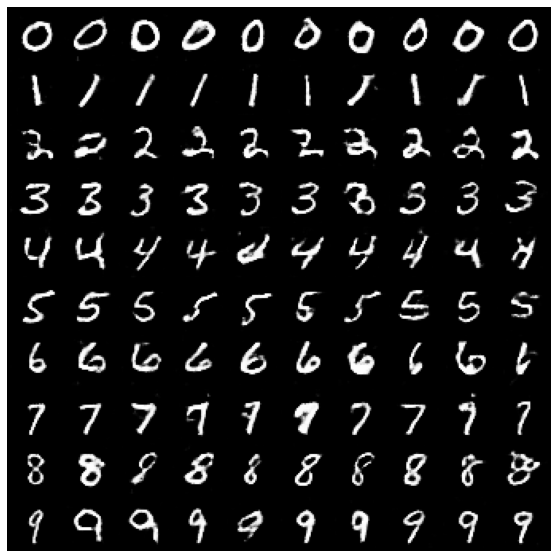

[ 2225/ 7812]	Loss_D: 1.1501	Loss_G: 1.2034	D(x): 0.5826	D(G(z)): 0.4063
[ 2250/ 7812]	Loss_D: 1.1935	Loss_G: 0.8664	D(x): 0.5108	D(G(z)): 0.3420
[ 2275/ 7812]	Loss_D: 1.3527	Loss_G: 0.6454	D(x): 0.4518	D(G(z)): 0.3568
[ 2300/ 7812]	Loss_D: 1.2185	Loss_G: 1.1634	D(x): 0.6089	D(G(z)): 0.4665


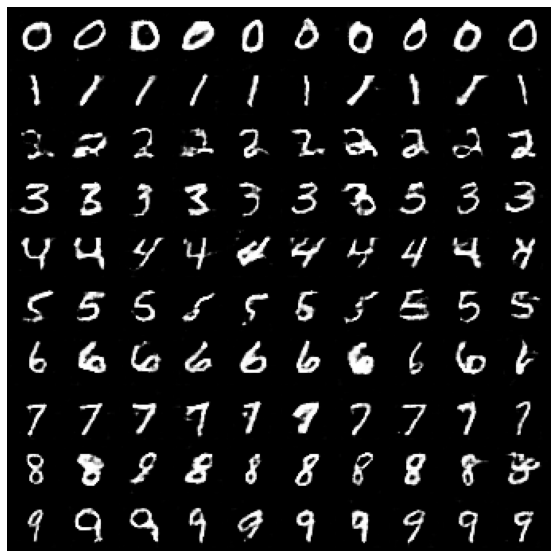

[ 2325/ 7812]	Loss_D: 1.3846	Loss_G: 0.8804	D(x): 0.4339	D(G(z)): 0.3262
[ 2350/ 7812]	Loss_D: 1.0897	Loss_G: 1.0143	D(x): 0.6302	D(G(z)): 0.4224
[ 2375/ 7812]	Loss_D: 1.2335	Loss_G: 0.8437	D(x): 0.5227	D(G(z)): 0.3866
[ 2400/ 7812]	Loss_D: 1.2965	Loss_G: 1.4904	D(x): 0.6856	D(G(z)): 0.5579


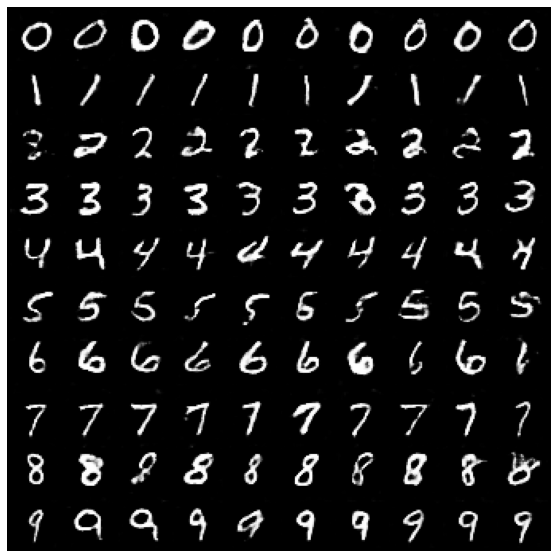

[ 2425/ 7812]	Loss_D: 1.2821	Loss_G: 1.2675	D(x): 0.6021	D(G(z)): 0.4945
[ 2450/ 7812]	Loss_D: 1.2174	Loss_G: 1.0211	D(x): 0.5647	D(G(z)): 0.4325
[ 2475/ 7812]	Loss_D: 1.2429	Loss_G: 0.9566	D(x): 0.5228	D(G(z)): 0.3878
[ 2500/ 7812]	Loss_D: 1.7116	Loss_G: 0.3997	D(x): 0.2720	D(G(z)): 0.1908


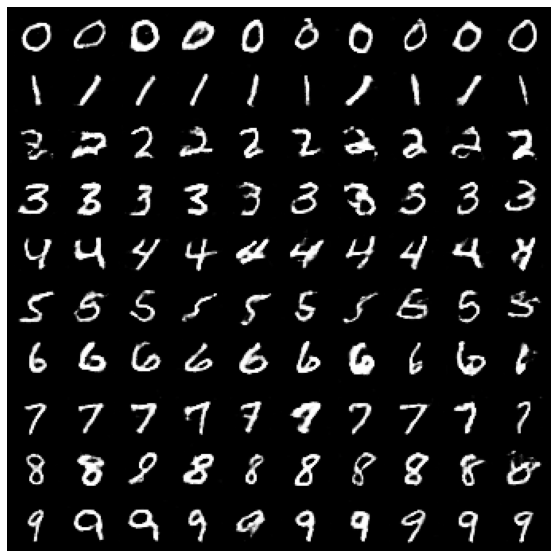

[ 2525/ 7812]	Loss_D: 1.2997	Loss_G: 1.0158	D(x): 0.5673	D(G(z)): 0.4688
[ 2550/ 7812]	Loss_D: 1.3347	Loss_G: 0.7446	D(x): 0.4481	D(G(z)): 0.3496
[ 2575/ 7812]	Loss_D: 1.3150	Loss_G: 1.4438	D(x): 0.6453	D(G(z)): 0.5404
[ 2600/ 7812]	Loss_D: 1.1591	Loss_G: 0.9770	D(x): 0.5753	D(G(z)): 0.4101


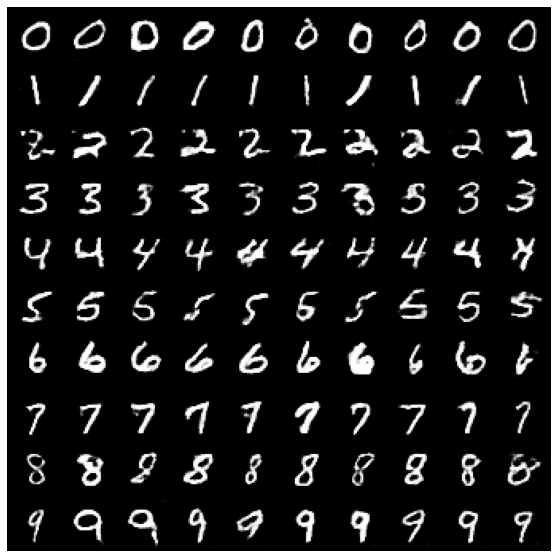

[ 2625/ 7812]	Loss_D: 1.2537	Loss_G: 0.8928	D(x): 0.4636	D(G(z)): 0.3121
[ 2650/ 7812]	Loss_D: 1.2972	Loss_G: 1.3790	D(x): 0.7255	D(G(z)): 0.5867
[ 2675/ 7812]	Loss_D: 1.1725	Loss_G: 0.9799	D(x): 0.6063	D(G(z)): 0.4487
[ 2700/ 7812]	Loss_D: 1.1597	Loss_G: 0.9259	D(x): 0.6195	D(G(z)): 0.4468


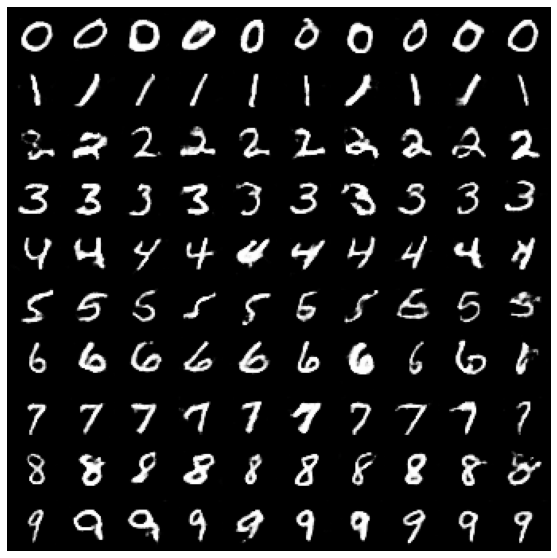

[ 2725/ 7812]	Loss_D: 1.3017	Loss_G: 1.1419	D(x): 0.6430	D(G(z)): 0.5312
[ 2750/ 7812]	Loss_D: 1.2591	Loss_G: 1.2087	D(x): 0.7101	D(G(z)): 0.5555
[ 2775/ 7812]	Loss_D: 1.1270	Loss_G: 1.2262	D(x): 0.6474	D(G(z)): 0.4613
[ 2800/ 7812]	Loss_D: 1.2177	Loss_G: 0.8657	D(x): 0.5369	D(G(z)): 0.3979


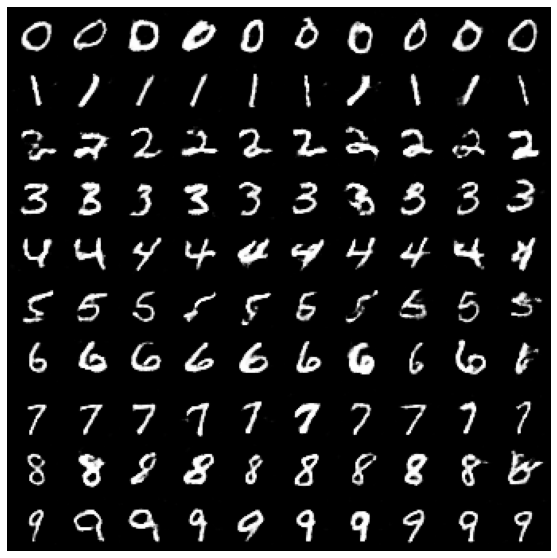

[ 2825/ 7812]	Loss_D: 1.1980	Loss_G: 1.1847	D(x): 0.5547	D(G(z)): 0.4088
[ 2850/ 7812]	Loss_D: 1.1562	Loss_G: 0.7164	D(x): 0.4963	D(G(z)): 0.3021
[ 2875/ 7812]	Loss_D: 1.2027	Loss_G: 1.2836	D(x): 0.6190	D(G(z)): 0.4757
[ 2900/ 7812]	Loss_D: 1.2126	Loss_G: 1.7012	D(x): 0.6931	D(G(z)): 0.5270


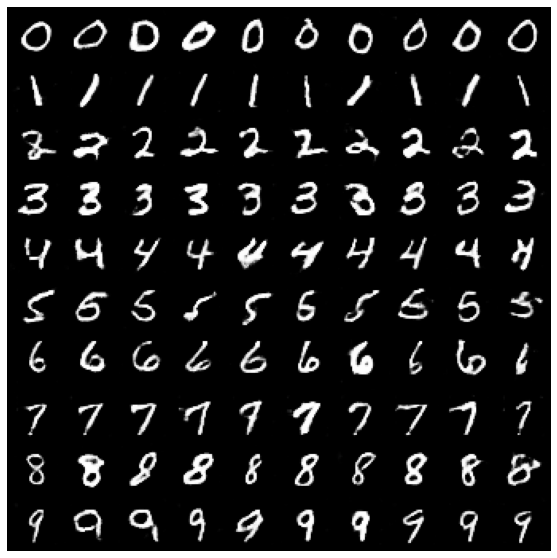

[ 2925/ 7812]	Loss_D: 1.1687	Loss_G: 0.8388	D(x): 0.5147	D(G(z)): 0.3352
[ 2950/ 7812]	Loss_D: 1.2415	Loss_G: 1.4045	D(x): 0.6582	D(G(z)): 0.5192
[ 2975/ 7812]	Loss_D: 1.1500	Loss_G: 1.0111	D(x): 0.5375	D(G(z)): 0.3622
[ 3000/ 7812]	Loss_D: 1.1378	Loss_G: 0.6787	D(x): 0.5160	D(G(z)): 0.3223


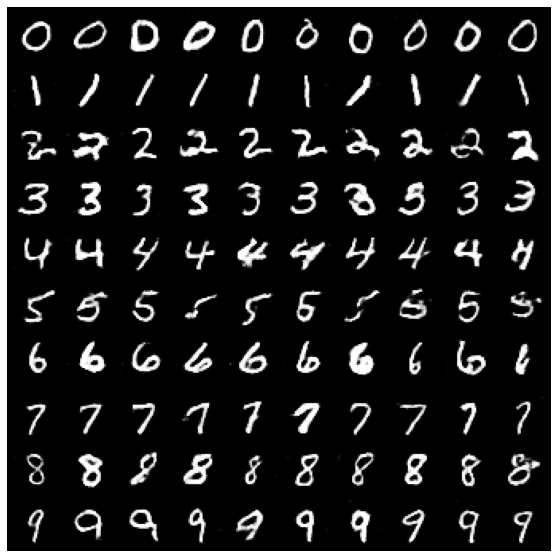

[ 3025/ 7812]	Loss_D: 1.2843	Loss_G: 0.8465	D(x): 0.4952	D(G(z)): 0.3782
[ 3050/ 7812]	Loss_D: 1.1917	Loss_G: 1.3495	D(x): 0.6651	D(G(z)): 0.5020
[ 3075/ 7812]	Loss_D: 1.3608	Loss_G: 0.6691	D(x): 0.4274	D(G(z)): 0.3120
[ 3100/ 7812]	Loss_D: 1.4760	Loss_G: 1.6426	D(x): 0.7678	D(G(z)): 0.6696


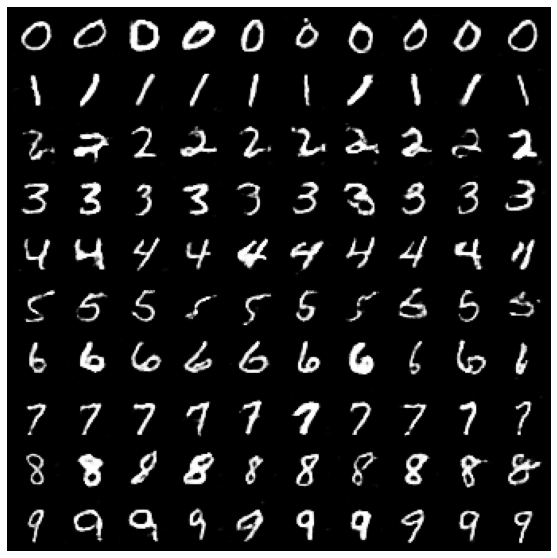

[ 3125/ 7812]	Loss_D: 1.2826	Loss_G: 0.9077	D(x): 0.5061	D(G(z)): 0.3782
[ 3150/ 7812]	Loss_D: 1.2163	Loss_G: 1.0414	D(x): 0.5433	D(G(z)): 0.3966
[ 3175/ 7812]	Loss_D: 1.3619	Loss_G: 1.2470	D(x): 0.6244	D(G(z)): 0.5449
[ 3200/ 7812]	Loss_D: 1.4639	Loss_G: 2.2527	D(x): 0.7365	D(G(z)): 0.6445


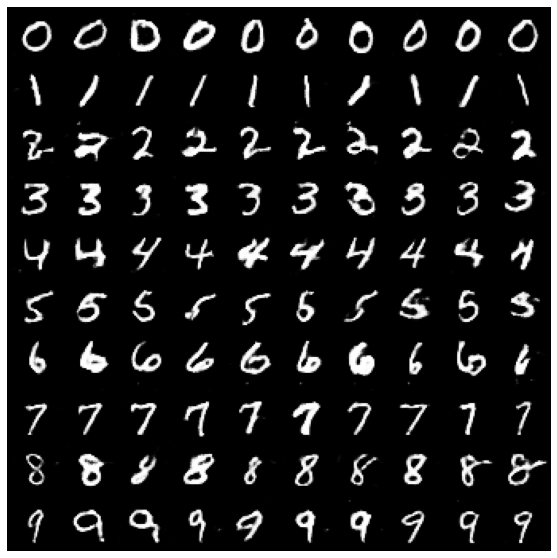

[ 3225/ 7812]	Loss_D: 1.2723	Loss_G: 1.2441	D(x): 0.6972	D(G(z)): 0.5552
[ 3250/ 7812]	Loss_D: 1.2059	Loss_G: 1.1507	D(x): 0.6360	D(G(z)): 0.4842
[ 3275/ 7812]	Loss_D: 1.2868	Loss_G: 1.3133	D(x): 0.5954	D(G(z)): 0.4939
[ 3300/ 7812]	Loss_D: 1.3676	Loss_G: 1.1188	D(x): 0.6473	D(G(z)): 0.5622


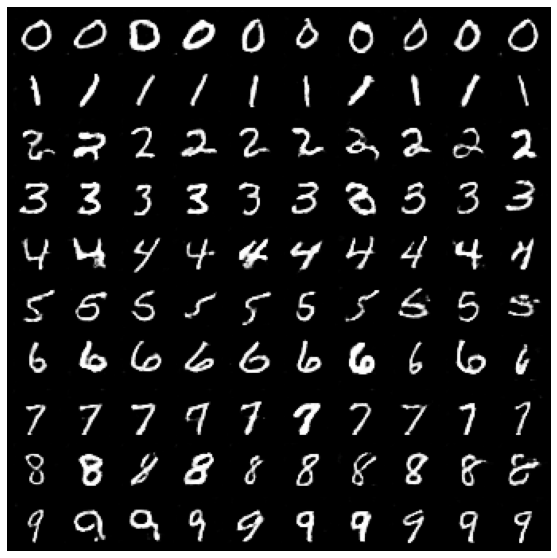

[ 3325/ 7812]	Loss_D: 1.3158	Loss_G: 1.3392	D(x): 0.6535	D(G(z)): 0.5479
[ 3350/ 7812]	Loss_D: 1.3191	Loss_G: 0.7542	D(x): 0.4214	D(G(z)): 0.3054
[ 3375/ 7812]	Loss_D: 1.1403	Loss_G: 0.9224	D(x): 0.5909	D(G(z)): 0.4161
[ 3400/ 7812]	Loss_D: 1.2690	Loss_G: 1.3608	D(x): 0.7371	D(G(z)): 0.5804


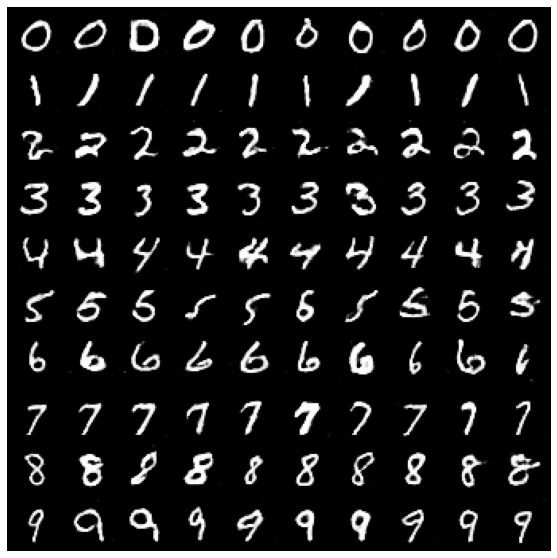

[ 3425/ 7812]	Loss_D: 1.1862	Loss_G: 1.1904	D(x): 0.6293	D(G(z)): 0.4735
[ 3450/ 7812]	Loss_D: 1.2491	Loss_G: 1.2722	D(x): 0.6519	D(G(z)): 0.5153
[ 3475/ 7812]	Loss_D: 1.2546	Loss_G: 1.1128	D(x): 0.6140	D(G(z)): 0.4962
[ 3500/ 7812]	Loss_D: 1.1896	Loss_G: 0.9405	D(x): 0.5392	D(G(z)): 0.3961


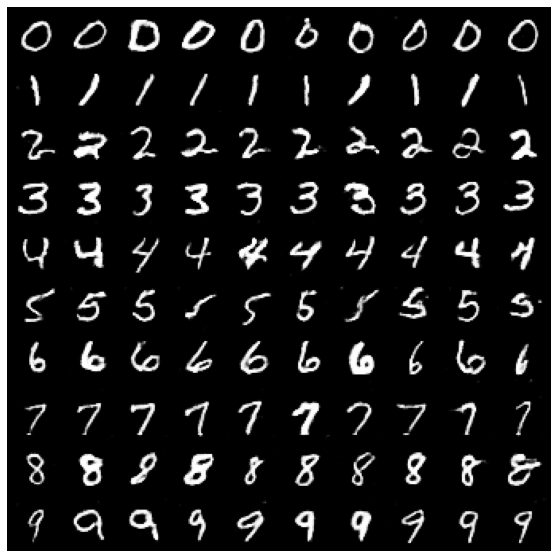

[ 3525/ 7812]	Loss_D: 1.2287	Loss_G: 1.2165	D(x): 0.6029	D(G(z)): 0.4677
[ 3550/ 7812]	Loss_D: 1.1420	Loss_G: 1.0489	D(x): 0.5765	D(G(z)): 0.4037
[ 3575/ 7812]	Loss_D: 1.2057	Loss_G: 1.0201	D(x): 0.6238	D(G(z)): 0.4866
[ 3600/ 7812]	Loss_D: 1.1963	Loss_G: 1.0708	D(x): 0.6276	D(G(z)): 0.4832


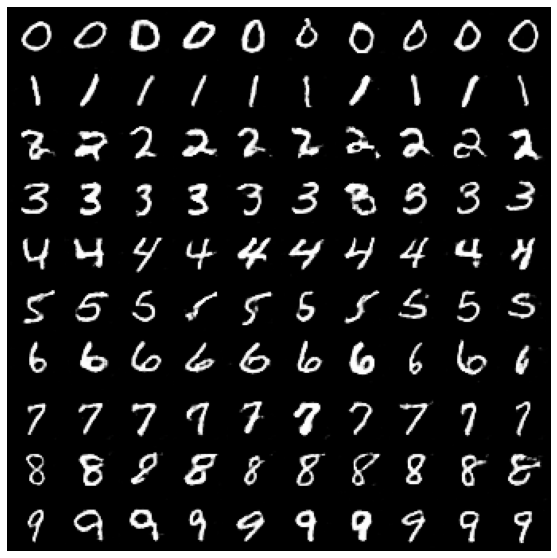

[ 3625/ 7812]	Loss_D: 1.1636	Loss_G: 1.0856	D(x): 0.6279	D(G(z)): 0.4646
[ 3650/ 7812]	Loss_D: 1.2141	Loss_G: 0.9990	D(x): 0.5681	D(G(z)): 0.4355
[ 3675/ 7812]	Loss_D: 1.1986	Loss_G: 0.9915	D(x): 0.5508	D(G(z)): 0.4046
[ 3700/ 7812]	Loss_D: 1.6683	Loss_G: 0.7830	D(x): 0.2682	D(G(z)): 0.1825


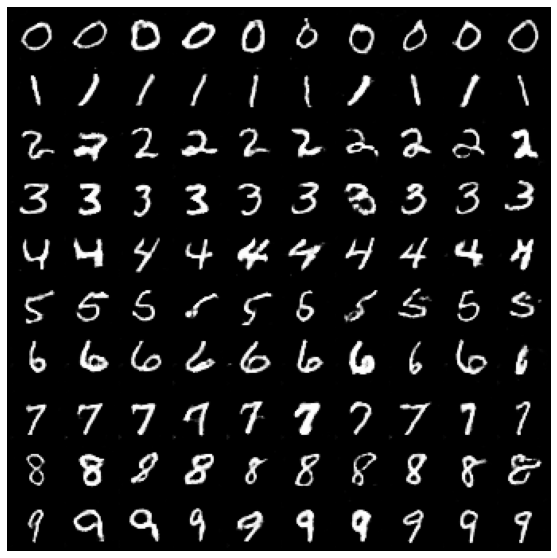

[ 3725/ 7812]	Loss_D: 1.2574	Loss_G: 1.0547	D(x): 0.5963	D(G(z)): 0.4839
[ 3750/ 7812]	Loss_D: 1.2290	Loss_G: 1.0382	D(x): 0.5430	D(G(z)): 0.4203
[ 3775/ 7812]	Loss_D: 1.2260	Loss_G: 0.9336	D(x): 0.5944	D(G(z)): 0.4681
[ 3800/ 7812]	Loss_D: 1.2592	Loss_G: 1.1103	D(x): 0.6321	D(G(z)): 0.5070


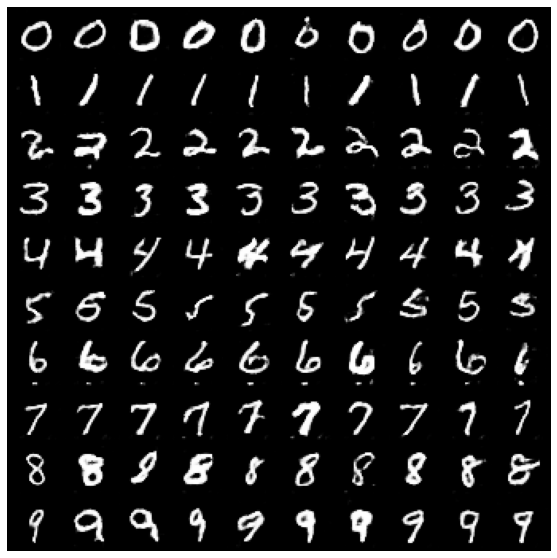

[ 3825/ 7812]	Loss_D: 1.1727	Loss_G: 1.0576	D(x): 0.6027	D(G(z)): 0.4556
[ 3850/ 7812]	Loss_D: 1.2596	Loss_G: 1.1883	D(x): 0.6149	D(G(z)): 0.5076
[ 3875/ 7812]	Loss_D: 1.3040	Loss_G: 1.4642	D(x): 0.7418	D(G(z)): 0.6080
[ 3900/ 7812]	Loss_D: 1.3843	Loss_G: 1.7334	D(x): 0.7487	D(G(z)): 0.6288


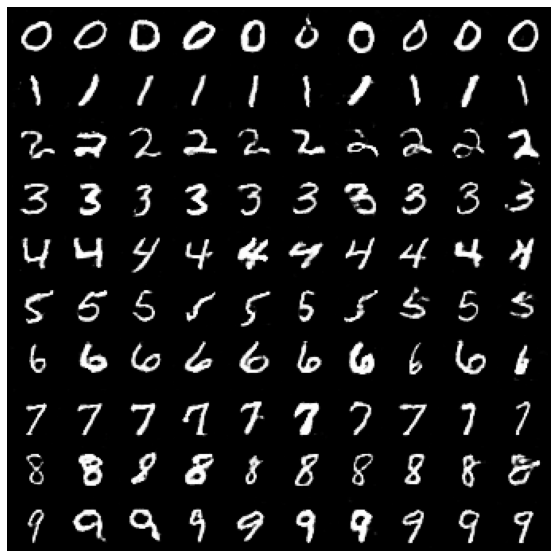

[ 3925/ 7812]	Loss_D: 1.2674	Loss_G: 1.1724	D(x): 0.7118	D(G(z)): 0.5695
[ 3950/ 7812]	Loss_D: 1.2035	Loss_G: 0.9454	D(x): 0.5758	D(G(z)): 0.4456
[ 3975/ 7812]	Loss_D: 1.1728	Loss_G: 0.8168	D(x): 0.5525	D(G(z)): 0.4030
[ 4000/ 7812]	Loss_D: 1.2376	Loss_G: 0.9419	D(x): 0.5561	D(G(z)): 0.4226


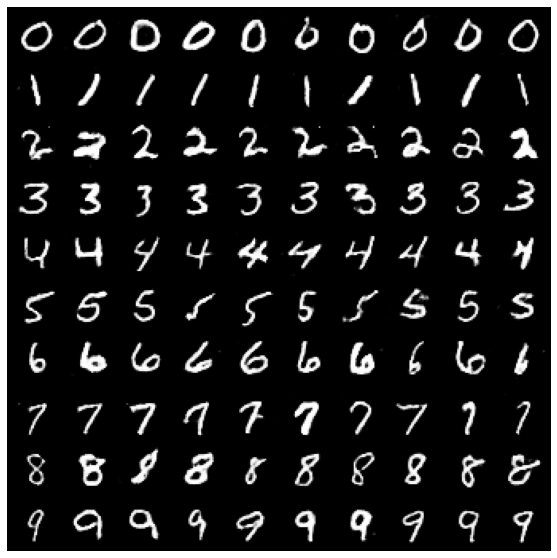

[ 4025/ 7812]	Loss_D: 1.4659	Loss_G: 0.7925	D(x): 0.3553	D(G(z)): 0.2693
[ 4050/ 7812]	Loss_D: 1.2217	Loss_G: 0.9672	D(x): 0.5127	D(G(z)): 0.3721
[ 4075/ 7812]	Loss_D: 1.2086	Loss_G: 1.0454	D(x): 0.4573	D(G(z)): 0.2919
[ 4100/ 7812]	Loss_D: 1.3400	Loss_G: 0.7425	D(x): 0.4451	D(G(z)): 0.3597


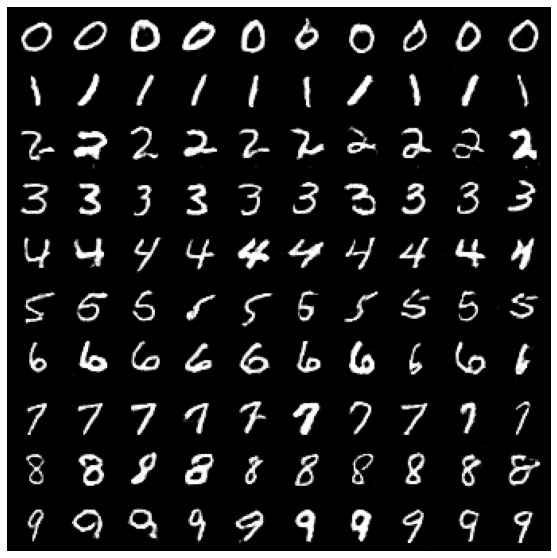

[ 4125/ 7812]	Loss_D: 1.2598	Loss_G: 0.9126	D(x): 0.5337	D(G(z)): 0.4250
[ 4150/ 7812]	Loss_D: 1.3748	Loss_G: 0.7436	D(x): 0.4526	D(G(z)): 0.3878
[ 4175/ 7812]	Loss_D: 1.3153	Loss_G: 0.8039	D(x): 0.4571	D(G(z)): 0.3661
[ 4200/ 7812]	Loss_D: 1.2623	Loss_G: 1.3304	D(x): 0.6165	D(G(z)): 0.5075


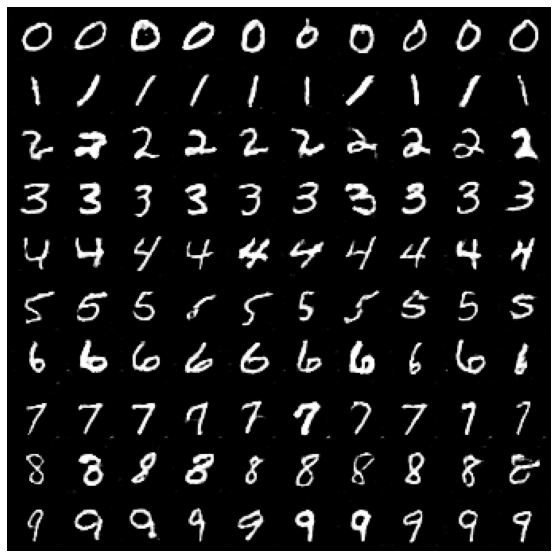

[ 4225/ 7812]	Loss_D: 1.3531	Loss_G: 0.5114	D(x): 0.3971	D(G(z)): 0.3023
[ 4250/ 7812]	Loss_D: 1.5184	Loss_G: 1.6573	D(x): 0.7748	D(G(z)): 0.6827
[ 4275/ 7812]	Loss_D: 1.1653	Loss_G: 1.1330	D(x): 0.6951	D(G(z)): 0.5153
learning rate change!
[ 4300/ 7812]	Loss_D: 1.1640	Loss_G: 0.9854	D(x): 0.5507	D(G(z)): 0.4080


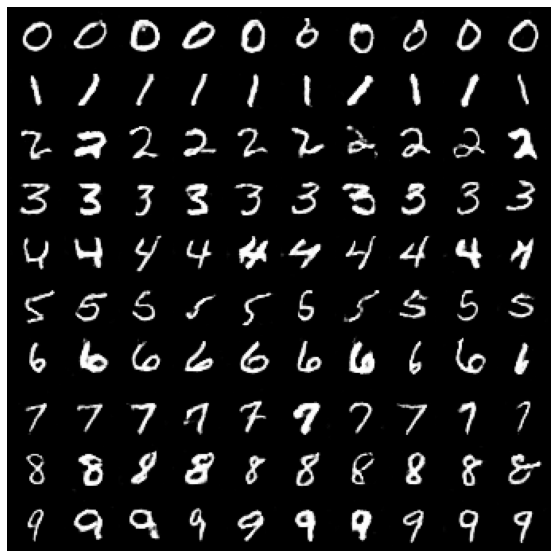

[ 4325/ 7812]	Loss_D: 1.1657	Loss_G: 0.8827	D(x): 0.5690	D(G(z)): 0.4271
[ 4350/ 7812]	Loss_D: 1.1320	Loss_G: 0.8861	D(x): 0.5646	D(G(z)): 0.4047
[ 4375/ 7812]	Loss_D: 1.1853	Loss_G: 0.9217	D(x): 0.5666	D(G(z)): 0.4357
[ 4400/ 7812]	Loss_D: 1.1678	Loss_G: 0.8920	D(x): 0.5577	D(G(z)): 0.4217


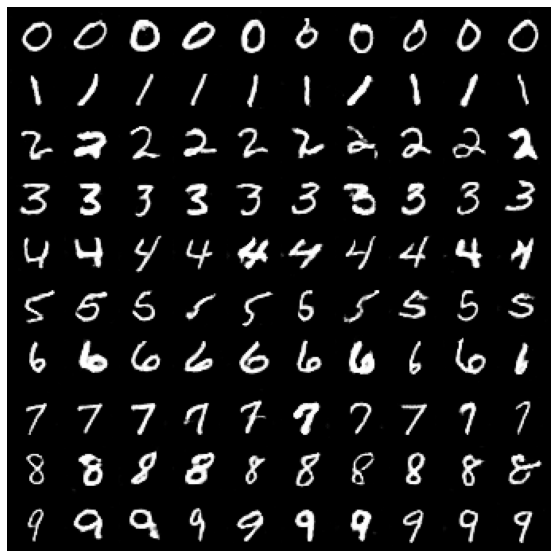

[ 4425/ 7812]	Loss_D: 1.0969	Loss_G: 0.8480	D(x): 0.5960	D(G(z)): 0.4201
[ 4450/ 7812]	Loss_D: 1.0935	Loss_G: 0.9074	D(x): 0.6085	D(G(z)): 0.4290
[ 4475/ 7812]	Loss_D: 1.1685	Loss_G: 0.8758	D(x): 0.5770	D(G(z)): 0.4403
[ 4500/ 7812]	Loss_D: 1.1553	Loss_G: 0.9267	D(x): 0.5420	D(G(z)): 0.3986


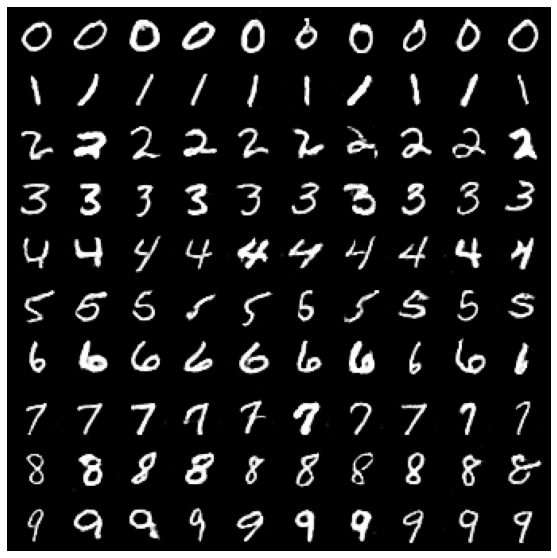

[ 4525/ 7812]	Loss_D: 1.0965	Loss_G: 0.8567	D(x): 0.5763	D(G(z)): 0.3987
[ 4550/ 7812]	Loss_D: 1.1254	Loss_G: 0.8888	D(x): 0.5920	D(G(z)): 0.4313
[ 4575/ 7812]	Loss_D: 1.1483	Loss_G: 0.8527	D(x): 0.5718	D(G(z)): 0.4241
[ 4600/ 7812]	Loss_D: 1.1703	Loss_G: 0.8854	D(x): 0.5813	D(G(z)): 0.4442


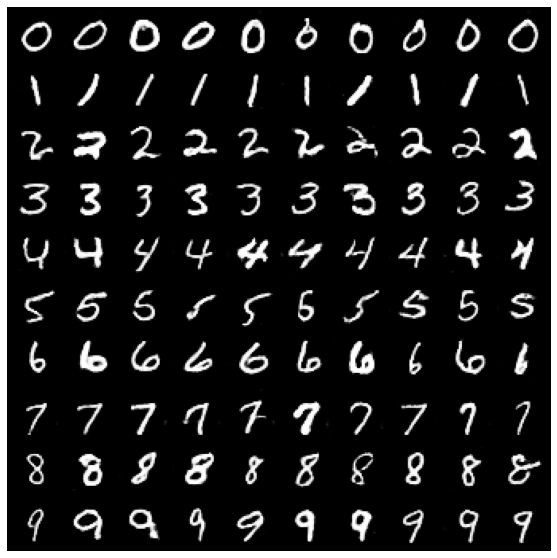

[ 4625/ 7812]	Loss_D: 1.1023	Loss_G: 0.8105	D(x): 0.5927	D(G(z)): 0.4164
[ 4650/ 7812]	Loss_D: 1.0644	Loss_G: 0.9157	D(x): 0.6134	D(G(z)): 0.4187
[ 4675/ 7812]	Loss_D: 1.1532	Loss_G: 0.8820	D(x): 0.5711	D(G(z)): 0.4259
[ 4700/ 7812]	Loss_D: 1.2213	Loss_G: 0.8131	D(x): 0.5725	D(G(z)): 0.4595


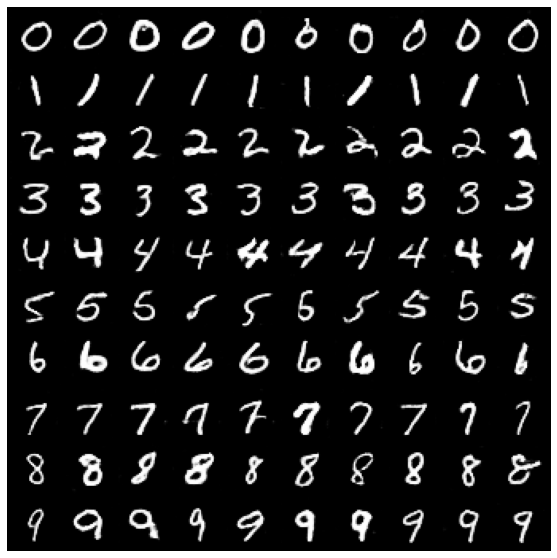

[ 4725/ 7812]	Loss_D: 1.0839	Loss_G: 0.9102	D(x): 0.5899	D(G(z)): 0.4074
[ 4750/ 7812]	Loss_D: 1.1733	Loss_G: 0.8775	D(x): 0.5659	D(G(z)): 0.4337
[ 4775/ 7812]	Loss_D: 1.0727	Loss_G: 0.9950	D(x): 0.6216	D(G(z)): 0.4269
[ 4800/ 7812]	Loss_D: 1.2027	Loss_G: 0.8388	D(x): 0.5685	D(G(z)): 0.4493


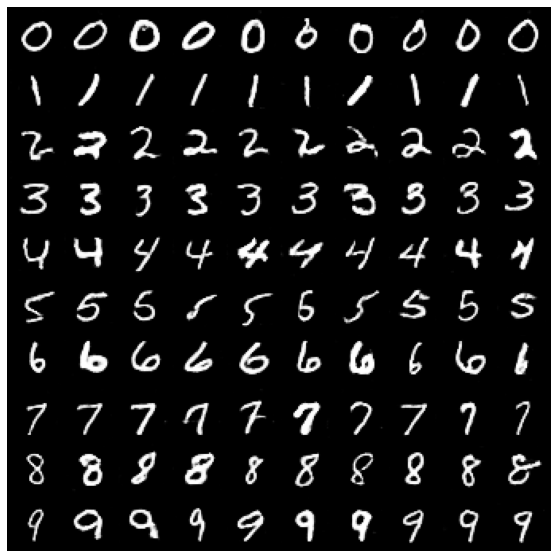

[ 4825/ 7812]	Loss_D: 1.0638	Loss_G: 0.8995	D(x): 0.6230	D(G(z)): 0.4280
[ 4850/ 7812]	Loss_D: 1.1490	Loss_G: 0.9236	D(x): 0.5996	D(G(z)): 0.4516
[ 4875/ 7812]	Loss_D: 1.1805	Loss_G: 0.9329	D(x): 0.5406	D(G(z)): 0.4123
[ 4900/ 7812]	Loss_D: 1.0898	Loss_G: 0.9319	D(x): 0.6143	D(G(z)): 0.4354


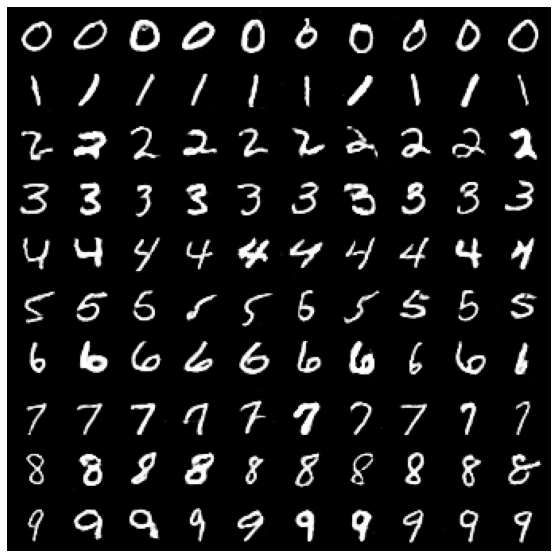

[ 4925/ 7812]	Loss_D: 1.1585	Loss_G: 0.8773	D(x): 0.5559	D(G(z)): 0.4122
[ 4950/ 7812]	Loss_D: 1.1190	Loss_G: 0.9088	D(x): 0.6182	D(G(z)): 0.4503
[ 4975/ 7812]	Loss_D: 1.1242	Loss_G: 0.8484	D(x): 0.5517	D(G(z)): 0.3889
[ 5000/ 7812]	Loss_D: 1.1231	Loss_G: 0.8845	D(x): 0.6004	D(G(z)): 0.4340


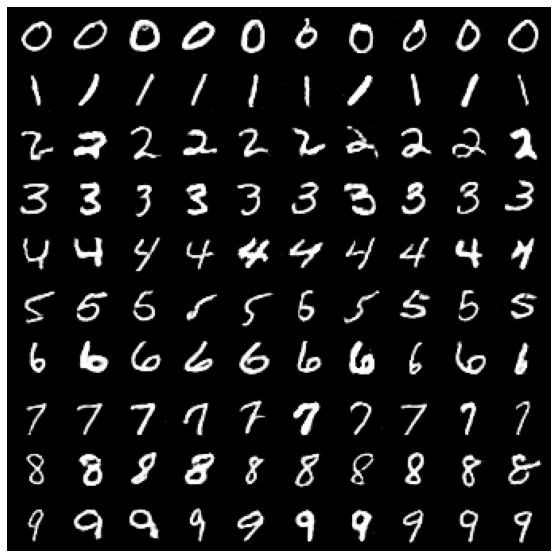

[ 5025/ 7812]	Loss_D: 1.1081	Loss_G: 0.8985	D(x): 0.5788	D(G(z)): 0.4084
[ 5050/ 7812]	Loss_D: 1.1082	Loss_G: 0.8631	D(x): 0.6130	D(G(z)): 0.4413
[ 5075/ 7812]	Loss_D: 1.1091	Loss_G: 0.9137	D(x): 0.5902	D(G(z)): 0.4215
[ 5100/ 7812]	Loss_D: 1.1164	Loss_G: 0.8440	D(x): 0.5861	D(G(z)): 0.4234


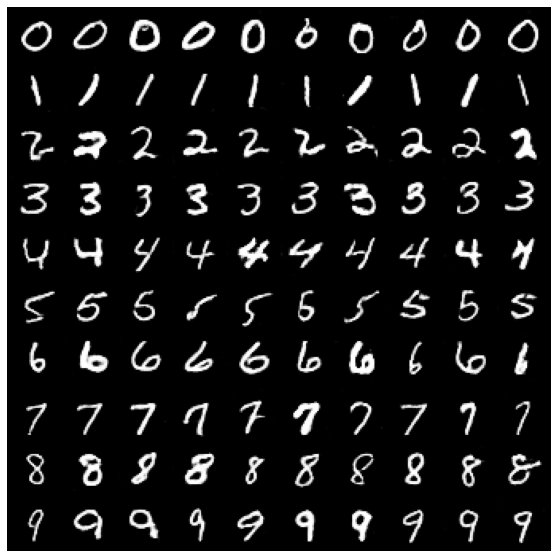

[ 5125/ 7812]	Loss_D: 1.1713	Loss_G: 0.8407	D(x): 0.5440	D(G(z)): 0.4085
[ 5150/ 7812]	Loss_D: 1.1032	Loss_G: 0.9338	D(x): 0.5978	D(G(z)): 0.4236
[ 5175/ 7812]	Loss_D: 1.1180	Loss_G: 0.9605	D(x): 0.5654	D(G(z)): 0.4027
[ 5200/ 7812]	Loss_D: 1.1616	Loss_G: 0.9145	D(x): 0.5664	D(G(z)): 0.4255


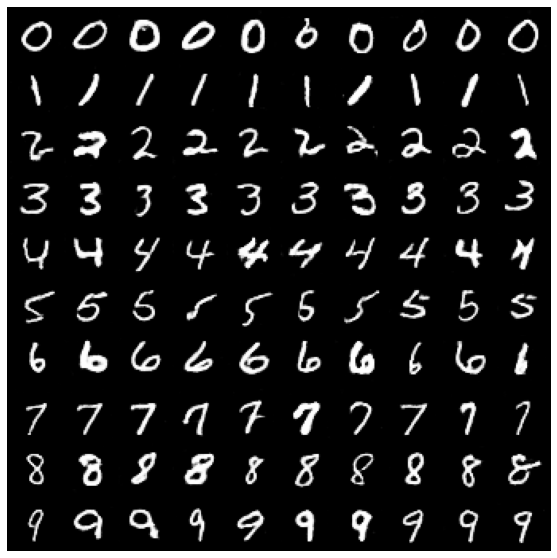

[ 5225/ 7812]	Loss_D: 1.1412	Loss_G: 0.9006	D(x): 0.6094	D(G(z)): 0.4546
[ 5250/ 7812]	Loss_D: 1.1519	Loss_G: 0.8853	D(x): 0.5918	D(G(z)): 0.4424
[ 5275/ 7812]	Loss_D: 1.1372	Loss_G: 0.9025	D(x): 0.5551	D(G(z)): 0.3985
[ 5300/ 7812]	Loss_D: 1.1133	Loss_G: 0.9497	D(x): 0.6015	D(G(z)): 0.4325


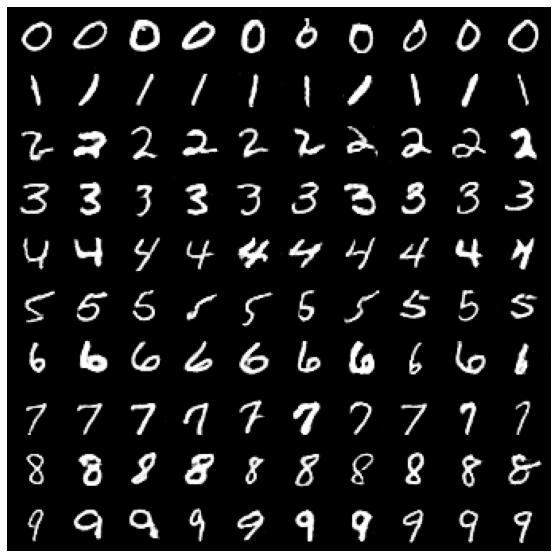

[ 5325/ 7812]	Loss_D: 1.1440	Loss_G: 0.9453	D(x): 0.5846	D(G(z)): 0.4361
[ 5350/ 7812]	Loss_D: 1.1934	Loss_G: 0.9418	D(x): 0.5396	D(G(z)): 0.4112
[ 5375/ 7812]	Loss_D: 1.1905	Loss_G: 0.8988	D(x): 0.5530	D(G(z)): 0.4274
[ 5400/ 7812]	Loss_D: 1.0583	Loss_G: 0.8764	D(x): 0.5940	D(G(z)): 0.3942


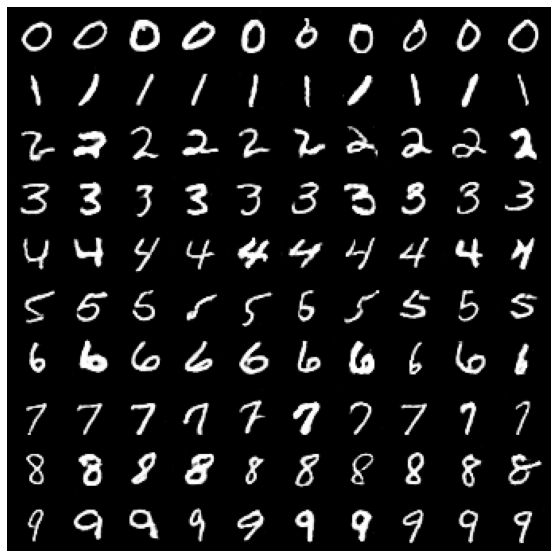

[ 5425/ 7812]	Loss_D: 1.1633	Loss_G: 0.9651	D(x): 0.5651	D(G(z)): 0.4241
[ 5450/ 7812]	Loss_D: 1.0950	Loss_G: 1.0185	D(x): 0.5949	D(G(z)): 0.4165
[ 5475/ 7812]	Loss_D: 1.0729	Loss_G: 0.8892	D(x): 0.5889	D(G(z)): 0.3977
[ 5500/ 7812]	Loss_D: 1.1868	Loss_G: 0.8314	D(x): 0.5675	D(G(z)): 0.4386


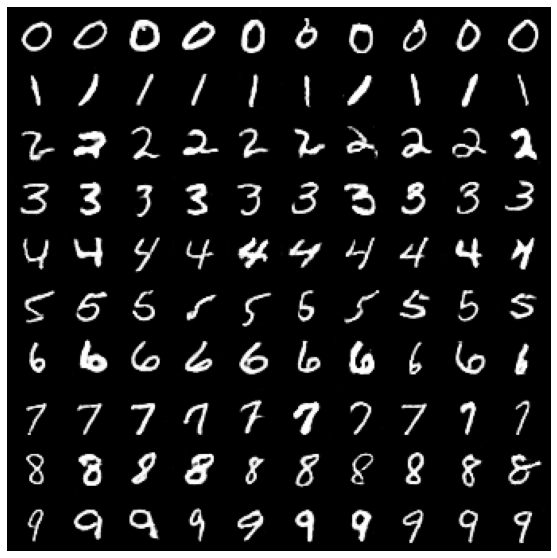

[ 5525/ 7812]	Loss_D: 1.1152	Loss_G: 0.9321	D(x): 0.5763	D(G(z)): 0.4074
[ 5550/ 7812]	Loss_D: 1.0491	Loss_G: 0.9266	D(x): 0.6147	D(G(z)): 0.4087
[ 5575/ 7812]	Loss_D: 1.1031	Loss_G: 1.0148	D(x): 0.6100	D(G(z)): 0.4336
[ 5600/ 7812]	Loss_D: 1.2034	Loss_G: 0.9036	D(x): 0.5622	D(G(z)): 0.4390


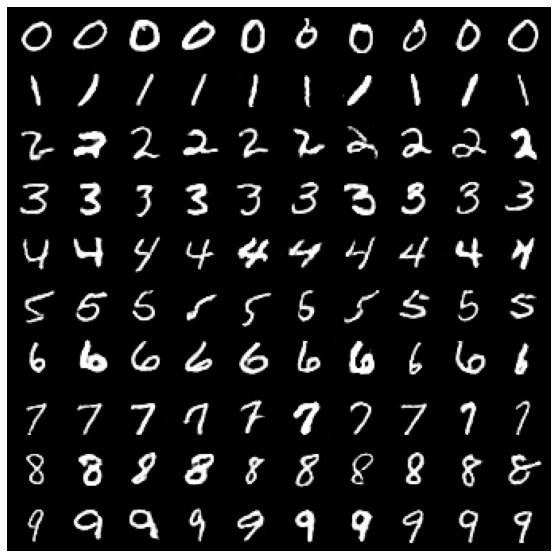

[ 5625/ 7812]	Loss_D: 1.0991	Loss_G: 0.8588	D(x): 0.5861	D(G(z)): 0.4067
[ 5650/ 7812]	Loss_D: 1.1513	Loss_G: 0.8840	D(x): 0.5635	D(G(z)): 0.4146
[ 5675/ 7812]	Loss_D: 1.1516	Loss_G: 0.9167	D(x): 0.5610	D(G(z)): 0.4102
[ 5700/ 7812]	Loss_D: 1.1356	Loss_G: 0.8572	D(x): 0.5715	D(G(z)): 0.4197


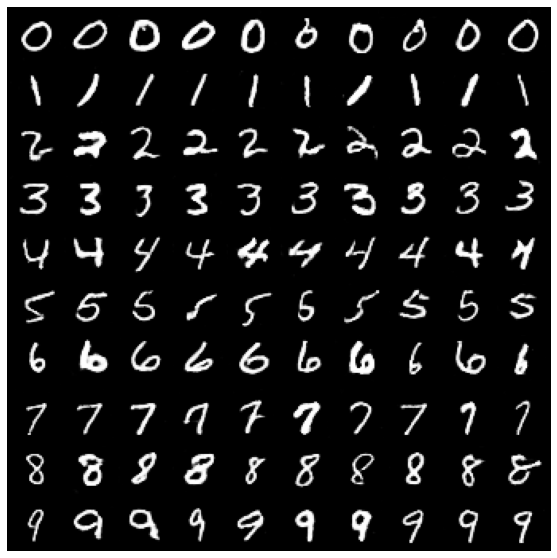

[ 5725/ 7812]	Loss_D: 1.0487	Loss_G: 1.0043	D(x): 0.6247	D(G(z)): 0.4169
[ 5750/ 7812]	Loss_D: 1.2165	Loss_G: 0.9183	D(x): 0.5379	D(G(z)): 0.4214
[ 5775/ 7812]	Loss_D: 1.1479	Loss_G: 0.9205	D(x): 0.6013	D(G(z)): 0.4470
[ 5800/ 7812]	Loss_D: 1.1613	Loss_G: 0.8729	D(x): 0.5420	D(G(z)): 0.3990


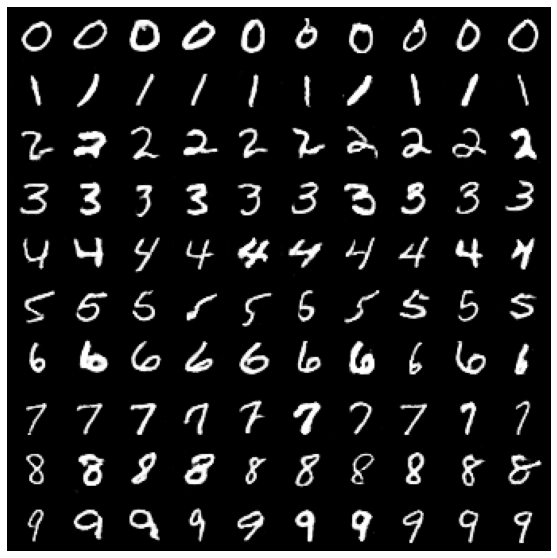

[ 5825/ 7812]	Loss_D: 1.1176	Loss_G: 0.9232	D(x): 0.5716	D(G(z)): 0.4030
[ 5850/ 7812]	Loss_D: 1.1577	Loss_G: 0.9330	D(x): 0.5874	D(G(z)): 0.4401
[ 5875/ 7812]	Loss_D: 1.1202	Loss_G: 0.8936	D(x): 0.5806	D(G(z)): 0.4149
[ 5900/ 7812]	Loss_D: 1.0891	Loss_G: 0.9133	D(x): 0.5954	D(G(z)): 0.4163


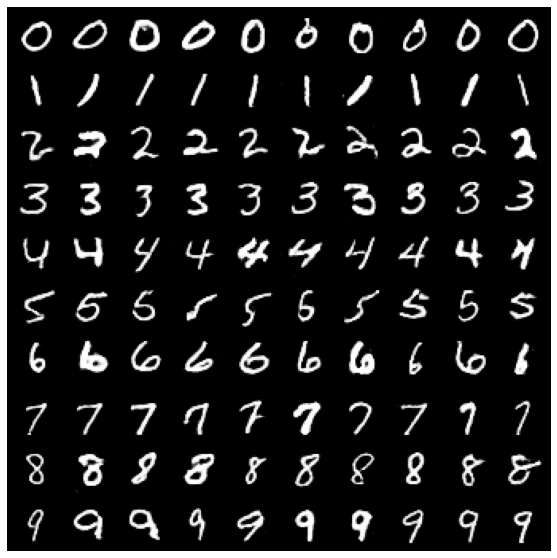

[ 5925/ 7812]	Loss_D: 1.0883	Loss_G: 0.9422	D(x): 0.5979	D(G(z)): 0.4144
[ 5950/ 7812]	Loss_D: 1.0308	Loss_G: 0.9650	D(x): 0.5921	D(G(z)): 0.3714
[ 5975/ 7812]	Loss_D: 1.1079	Loss_G: 0.9608	D(x): 0.5914	D(G(z)): 0.4140
[ 6000/ 7812]	Loss_D: 1.1332	Loss_G: 0.8787	D(x): 0.5646	D(G(z)): 0.3997


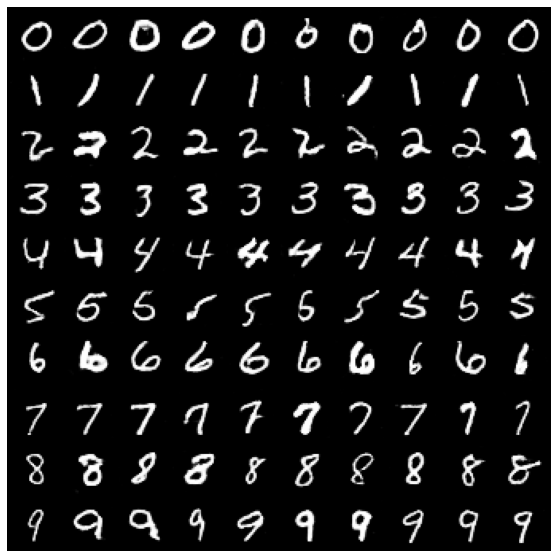

[ 6025/ 7812]	Loss_D: 1.0781	Loss_G: 0.8943	D(x): 0.6083	D(G(z)): 0.4181
[ 6050/ 7812]	Loss_D: 1.1275	Loss_G: 0.8974	D(x): 0.6036	D(G(z)): 0.4386
[ 6075/ 7812]	Loss_D: 1.1015	Loss_G: 0.9132	D(x): 0.6098	D(G(z)): 0.4303
[ 6100/ 7812]	Loss_D: 1.1071	Loss_G: 1.0102	D(x): 0.6042	D(G(z)): 0.4321


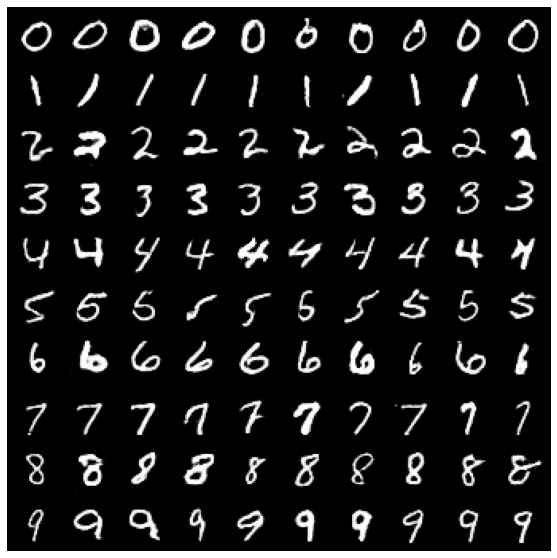

[ 6125/ 7812]	Loss_D: 1.0803	Loss_G: 1.0203	D(x): 0.6352	D(G(z)): 0.4453
[ 6150/ 7812]	Loss_D: 1.1297	Loss_G: 0.8689	D(x): 0.5767	D(G(z)): 0.4166
[ 6175/ 7812]	Loss_D: 1.1137	Loss_G: 0.8598	D(x): 0.5918	D(G(z)): 0.4222
[ 6200/ 7812]	Loss_D: 1.1783	Loss_G: 1.0221	D(x): 0.5640	D(G(z)): 0.4295


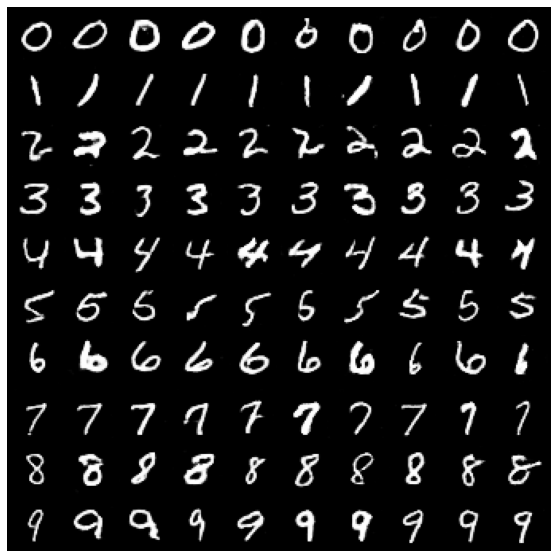

[ 6225/ 7812]	Loss_D: 1.0895	Loss_G: 0.9607	D(x): 0.5918	D(G(z)): 0.4072
learning rate change!
[ 6250/ 7812]	Loss_D: 1.1033	Loss_G: 0.9153	D(x): 0.6070	D(G(z)): 0.4248
[ 6275/ 7812]	Loss_D: 1.0889	Loss_G: 0.9446	D(x): 0.6150	D(G(z)): 0.4309
[ 6300/ 7812]	Loss_D: 1.0940	Loss_G: 0.8907	D(x): 0.5646	D(G(z)): 0.3809


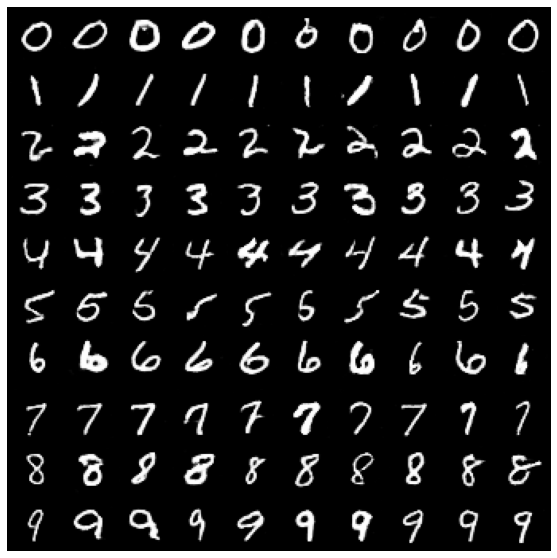

[ 6325/ 7812]	Loss_D: 1.0889	Loss_G: 0.8762	D(x): 0.6148	D(G(z)): 0.4280
[ 6350/ 7812]	Loss_D: 1.0449	Loss_G: 0.8910	D(x): 0.6184	D(G(z)): 0.4096
[ 6375/ 7812]	Loss_D: 1.2493	Loss_G: 0.9011	D(x): 0.5309	D(G(z)): 0.4304
[ 6400/ 7812]	Loss_D: 1.1599	Loss_G: 0.9748	D(x): 0.5849	D(G(z)): 0.4436


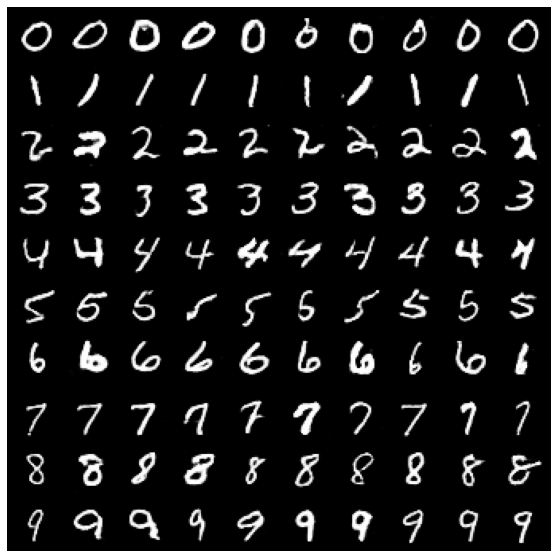

[ 6425/ 7812]	Loss_D: 1.0491	Loss_G: 0.9242	D(x): 0.6230	D(G(z)): 0.4159
[ 6450/ 7812]	Loss_D: 1.0706	Loss_G: 0.8532	D(x): 0.6083	D(G(z)): 0.4119
[ 6475/ 7812]	Loss_D: 1.1163	Loss_G: 0.9089	D(x): 0.5838	D(G(z)): 0.4169
[ 6500/ 7812]	Loss_D: 1.0262	Loss_G: 0.9672	D(x): 0.6061	D(G(z)): 0.3890


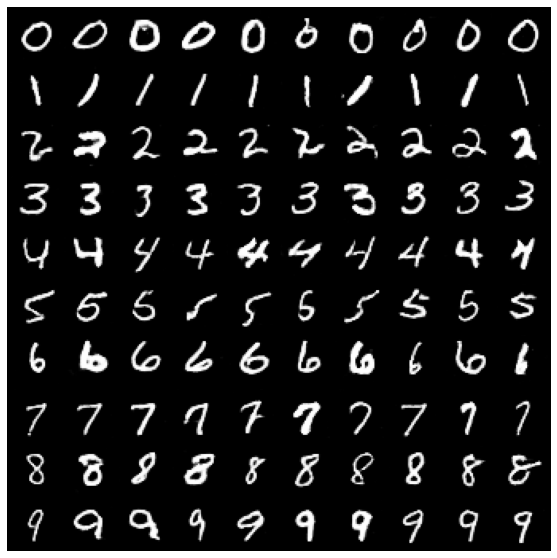

[ 6525/ 7812]	Loss_D: 1.0689	Loss_G: 0.9321	D(x): 0.5921	D(G(z)): 0.3958
[ 6550/ 7812]	Loss_D: 1.1690	Loss_G: 0.9064	D(x): 0.5602	D(G(z)): 0.4196
[ 6575/ 7812]	Loss_D: 1.0978	Loss_G: 0.9890	D(x): 0.5959	D(G(z)): 0.4189
[ 6600/ 7812]	Loss_D: 1.1117	Loss_G: 0.8932	D(x): 0.5968	D(G(z)): 0.4300


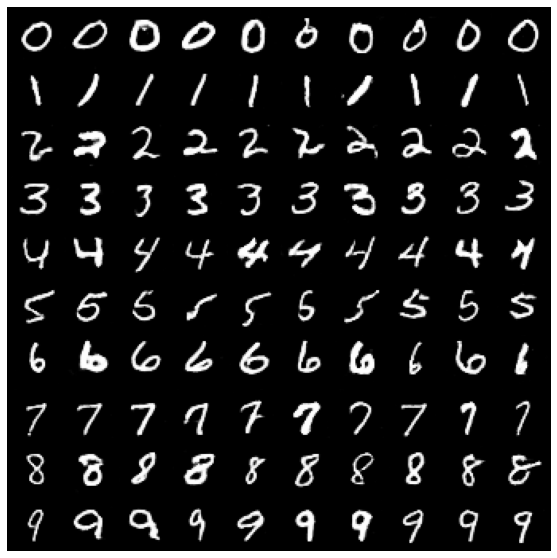

[ 6625/ 7812]	Loss_D: 1.1276	Loss_G: 0.9358	D(x): 0.5758	D(G(z)): 0.4146
[ 6650/ 7812]	Loss_D: 1.0817	Loss_G: 0.9414	D(x): 0.6196	D(G(z)): 0.4327
[ 6675/ 7812]	Loss_D: 1.1086	Loss_G: 0.8867	D(x): 0.5955	D(G(z)): 0.4244
[ 6700/ 7812]	Loss_D: 1.1729	Loss_G: 0.9083	D(x): 0.5871	D(G(z)): 0.4496


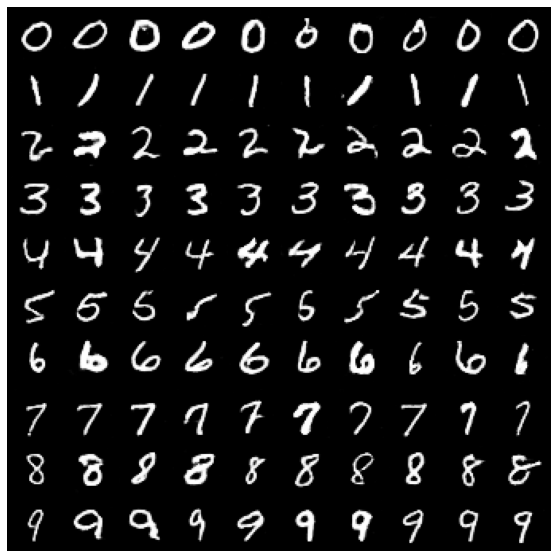

[ 6725/ 7812]	Loss_D: 1.0832	Loss_G: 0.8724	D(x): 0.5998	D(G(z)): 0.4160
[ 6750/ 7812]	Loss_D: 1.1684	Loss_G: 0.9027	D(x): 0.5469	D(G(z)): 0.4067
[ 6775/ 7812]	Loss_D: 1.0200	Loss_G: 0.9437	D(x): 0.5929	D(G(z)): 0.3675
[ 6800/ 7812]	Loss_D: 1.0835	Loss_G: 0.9607	D(x): 0.6046	D(G(z)): 0.4184


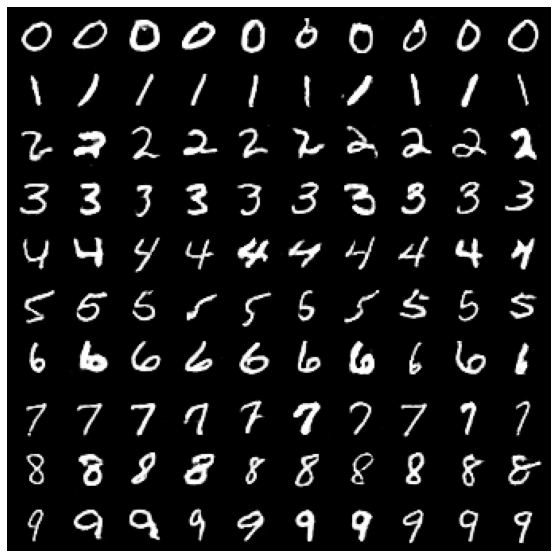

[ 6825/ 7812]	Loss_D: 1.0883	Loss_G: 1.0058	D(x): 0.6055	D(G(z)): 0.4230
[ 6850/ 7812]	Loss_D: 1.1116	Loss_G: 0.9006	D(x): 0.5968	D(G(z)): 0.4266
[ 6875/ 7812]	Loss_D: 1.0964	Loss_G: 0.9160	D(x): 0.5613	D(G(z)): 0.3856
[ 6900/ 7812]	Loss_D: 1.1486	Loss_G: 0.9089	D(x): 0.5710	D(G(z)): 0.4215


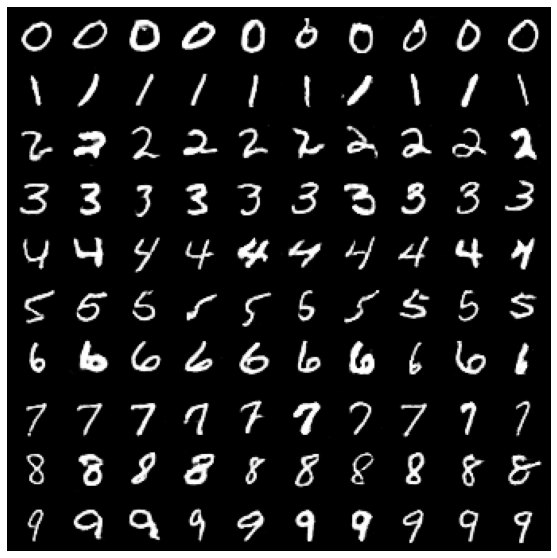

[ 6925/ 7812]	Loss_D: 1.0996	Loss_G: 0.9115	D(x): 0.5846	D(G(z)): 0.4079
[ 6950/ 7812]	Loss_D: 1.1493	Loss_G: 1.0197	D(x): 0.5669	D(G(z)): 0.4135
[ 6975/ 7812]	Loss_D: 1.1095	Loss_G: 0.9192	D(x): 0.5865	D(G(z)): 0.4133
[ 7000/ 7812]	Loss_D: 1.0892	Loss_G: 1.0147	D(x): 0.6037	D(G(z)): 0.4210


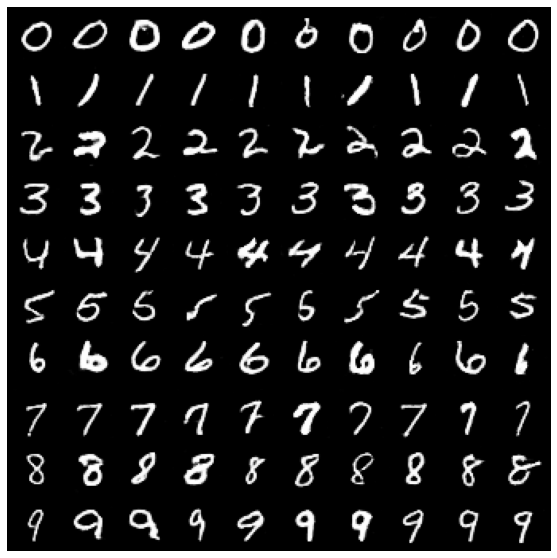

[ 7025/ 7812]	Loss_D: 1.1298	Loss_G: 0.9422	D(x): 0.5834	D(G(z)): 0.4243
[ 7050/ 7812]	Loss_D: 1.1590	Loss_G: 0.9090	D(x): 0.5463	D(G(z)): 0.3972
[ 7075/ 7812]	Loss_D: 1.0600	Loss_G: 0.9308	D(x): 0.6018	D(G(z)): 0.4035
[ 7100/ 7812]	Loss_D: 1.0830	Loss_G: 0.8464	D(x): 0.5965	D(G(z)): 0.4093


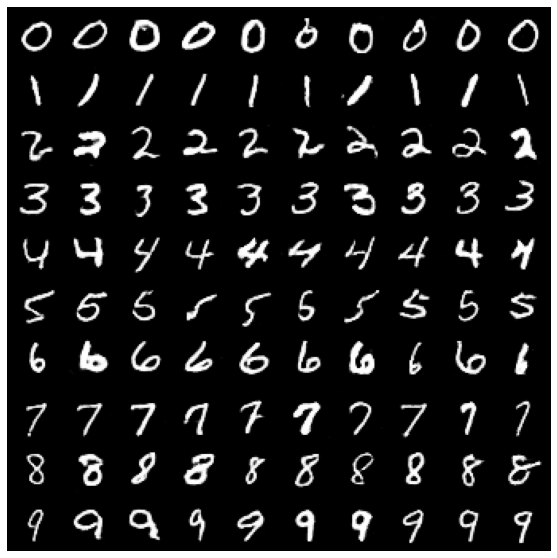

[ 7125/ 7812]	Loss_D: 1.0338	Loss_G: 0.9831	D(x): 0.6033	D(G(z)): 0.3899
[ 7150/ 7812]	Loss_D: 1.1070	Loss_G: 0.8935	D(x): 0.5818	D(G(z)): 0.4070
[ 7175/ 7812]	Loss_D: 1.1245	Loss_G: 0.9846	D(x): 0.5844	D(G(z)): 0.4238
[ 7200/ 7812]	Loss_D: 1.1262	Loss_G: 0.9621	D(x): 0.5895	D(G(z)): 0.4253


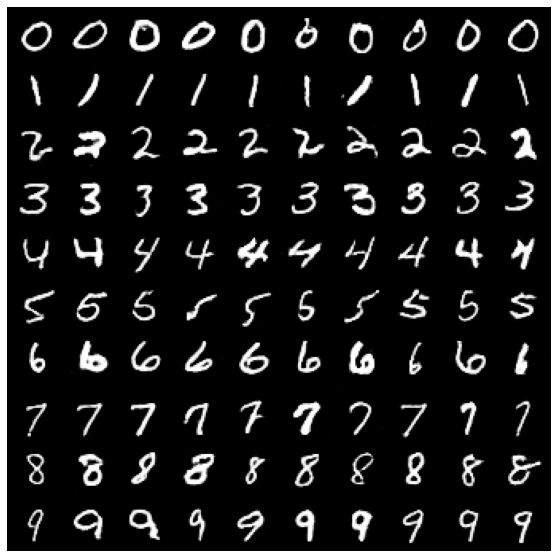

[ 7225/ 7812]	Loss_D: 1.0464	Loss_G: 0.9175	D(x): 0.6084	D(G(z)): 0.4027
[ 7250/ 7812]	Loss_D: 1.0811	Loss_G: 0.9126	D(x): 0.6124	D(G(z)): 0.4230
[ 7275/ 7812]	Loss_D: 1.0621	Loss_G: 0.9139	D(x): 0.6307	D(G(z)): 0.4297
[ 7300/ 7812]	Loss_D: 1.0817	Loss_G: 1.0226	D(x): 0.6029	D(G(z)): 0.4162


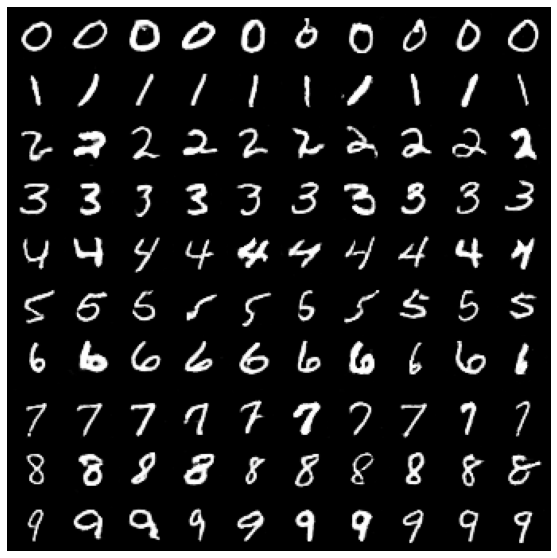

[ 7325/ 7812]	Loss_D: 1.1248	Loss_G: 0.8656	D(x): 0.5661	D(G(z)): 0.4042
[ 7350/ 7812]	Loss_D: 1.0490	Loss_G: 0.9685	D(x): 0.5942	D(G(z)): 0.3859
[ 7375/ 7812]	Loss_D: 1.0603	Loss_G: 1.0061	D(x): 0.6124	D(G(z)): 0.4112
[ 7400/ 7812]	Loss_D: 1.1488	Loss_G: 0.9260	D(x): 0.5591	D(G(z)): 0.4052


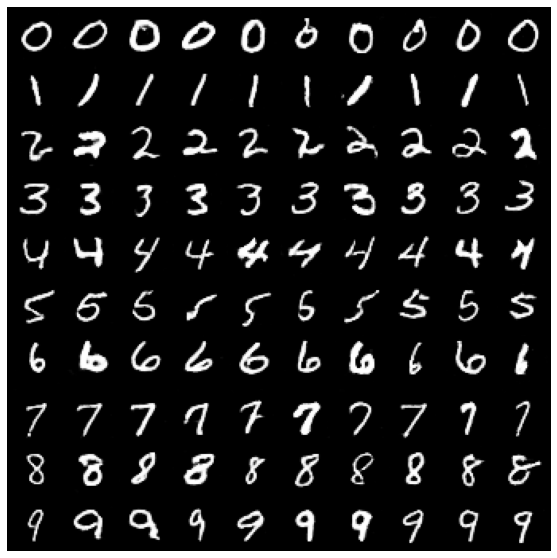

[ 7425/ 7812]	Loss_D: 1.0723	Loss_G: 0.9033	D(x): 0.5892	D(G(z)): 0.4001
[ 7450/ 7812]	Loss_D: 1.0563	Loss_G: 0.9697	D(x): 0.6016	D(G(z)): 0.4010
[ 7475/ 7812]	Loss_D: 1.0022	Loss_G: 0.9001	D(x): 0.6231	D(G(z)): 0.3905
[ 7500/ 7812]	Loss_D: 1.1109	Loss_G: 0.9308	D(x): 0.5704	D(G(z)): 0.4034


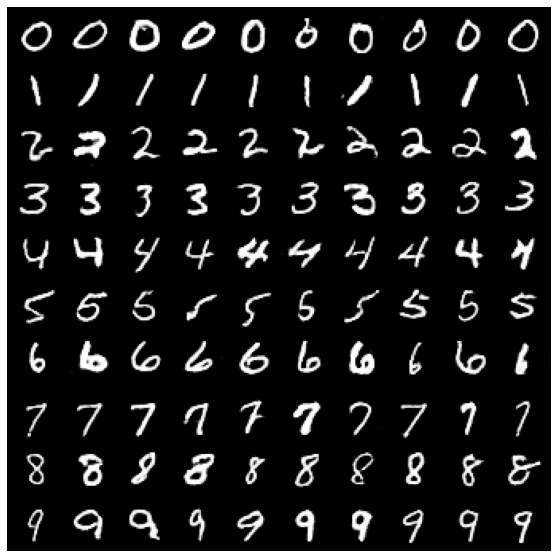

[ 7525/ 7812]	Loss_D: 1.0993	Loss_G: 0.9847	D(x): 0.5747	D(G(z)): 0.3991
[ 7550/ 7812]	Loss_D: 1.0762	Loss_G: 0.9642	D(x): 0.5982	D(G(z)): 0.4111
[ 7575/ 7812]	Loss_D: 1.0735	Loss_G: 0.9519	D(x): 0.5864	D(G(z)): 0.3962
[ 7600/ 7812]	Loss_D: 1.0984	Loss_G: 0.8963	D(x): 0.5981	D(G(z)): 0.4211


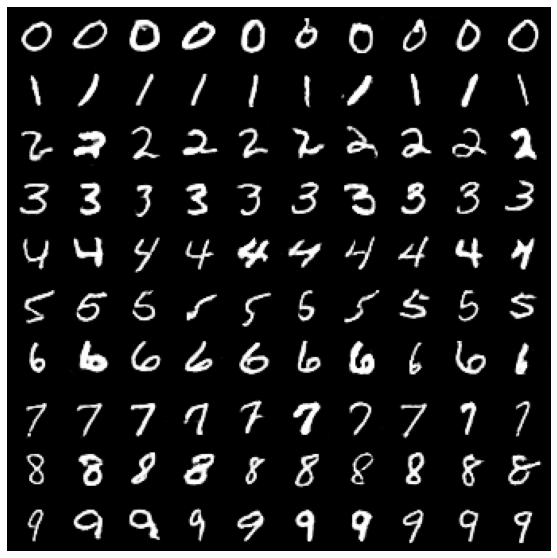

[ 7625/ 7812]	Loss_D: 1.0993	Loss_G: 0.8655	D(x): 0.5935	D(G(z)): 0.4193
[ 7650/ 7812]	Loss_D: 1.0674	Loss_G: 0.9522	D(x): 0.6091	D(G(z)): 0.4125
[ 7675/ 7812]	Loss_D: 1.0698	Loss_G: 0.9651	D(x): 0.5959	D(G(z)): 0.4018
[ 7700/ 7812]	Loss_D: 1.1649	Loss_G: 0.9084	D(x): 0.5579	D(G(z)): 0.4146


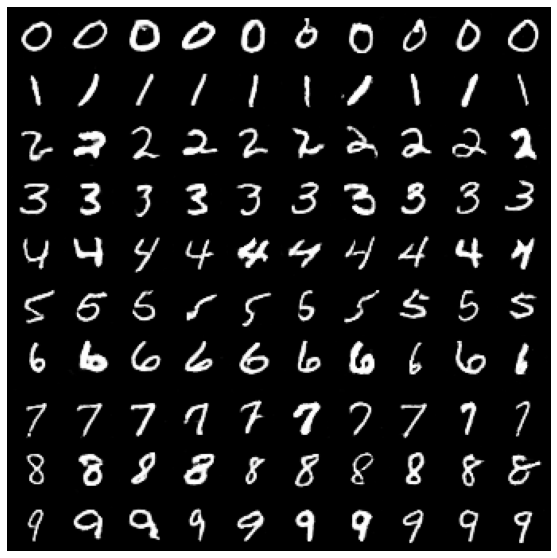

[ 7725/ 7812]	Loss_D: 1.0248	Loss_G: 0.9580	D(x): 0.6160	D(G(z)): 0.3982
[ 7750/ 7812]	Loss_D: 1.1090	Loss_G: 0.9275	D(x): 0.5718	D(G(z)): 0.3975
[ 7775/ 7812]	Loss_D: 1.1440	Loss_G: 0.9761	D(x): 0.5600	D(G(z)): 0.4066
[ 7800/ 7812]	Loss_D: 1.0650	Loss_G: 0.9374	D(x): 0.5802	D(G(z)): 0.3813


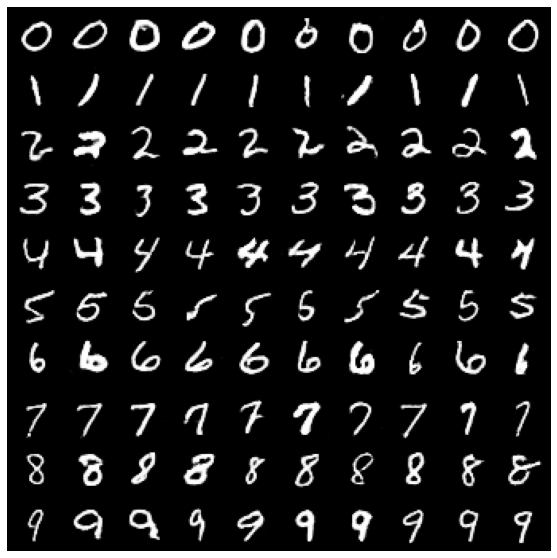

In [ ]:
for i in range(steps):
    
    if i == steps_per_epoch * 11:
        optimizerG.param_groups[0]['lr'] /= 10
        optimizerD.param_groups[0]['lr'] /= 10
        print("learning rate change!")
        
    if i == steps_per_epoch * 16:
        optimizerG.param_groups[0]['lr'] /= 10
        optimizerD.param_groups[0]['lr'] /= 10
        print("learning rate change!")
    
    ########
    # Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    for _ in range(nb_update_D):
        netD.zero_grad()
        
        # Create batches
        x_real, y_real, r_real = get_batch_real()
        x_fake, y_fake, r_fake = get_batch_fake(y_real)
        
        # Forward 
        r_hat_real = netD(x_real,y_real) # TODO
        r_hat_fake = netD(x_fake, y_fake) # TODO
        errD = (criterion(r_hat_real.squeeze(),r_real)+criterion(r_hat_fake.squeeze(),r_fake)).sum() # TODO sum of criterion of real and fake samples
        
        # Backward & optimization step on D
        errD.backward()
        optimizerD.step()
        
        # Compute / save metrics
        avg_output_for_real = r_hat_real.mean().item()
        avg_output_for_fake = r_hat_fake.mean().item()    
        D_losses.append(errD.item())



    ########
    # Update G network: maximize log(D(G(z)))
    for _ in range(nb_update_G):
        netG.zero_grad()

        x_fake, y_fake, r_fake = get_batch_fake(y_real, train_G=True)
        r_hat = netD(x_fake,y_fake)

        errG=criterion(r_hat.squeeze(),r_fake)
        errG.backward()
        optimizerG.step()
        # Compute / save metrics
        G_losses.append(errG.item())
        
    
    ########
    # Logs
    if i % 25 == 0:
        print('[%5d/%5d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f'
              % (i, steps, errD.item(), errG.item(), avg_output_for_real, avg_output_for_fake))

    if i % 100 == 0:
        with torch.no_grad():
            x_fake = netG(fixed_noise, fixed_y).detach().cpu()
        img_list.append(vutils.make_grid(x_fake, padding=2, normalize=True, nrow=10))
        plt.figure(figsize=(10,10))
        plt.imshow(np.transpose(img_list[-1],(1,2,0)))
        plt.axis("off")
        plt.show()

# Display training evolution

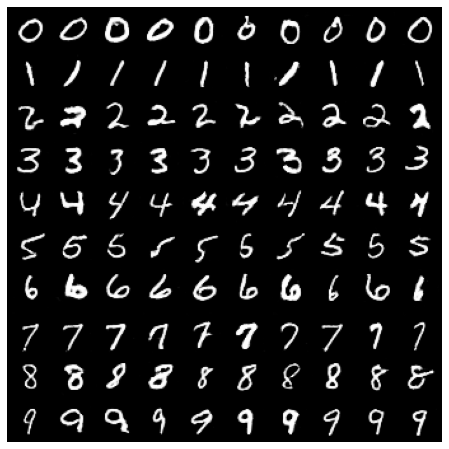

In [ ]:
# Show generations
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

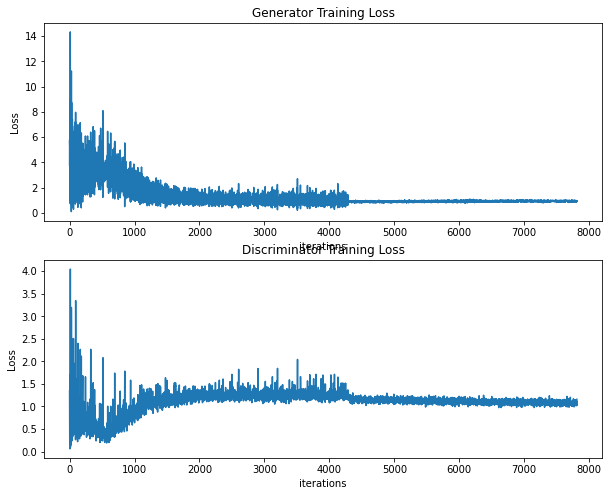

In [ ]:
# Loss evolution
plt.figure(figsize=(10,8))
plt.subplot(2,1,1)
plt.title("Generator Training Loss")
plt.plot(G_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")

plt.subplot(2,1,2)
plt.title("Discriminator Training Loss")
plt.plot(D_losses)
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.show()